In [1]:
# !pip install datasets
# !pip install transformers
# !pip install -U accelerate
# !pip install optuna
# !pip install shap
# !pip install lime
# !pip install transformers-interpret
# !pip install omnixai
# !pip install ipython>=8.10.0
# !pip install captum
# !pip install git+https://github.com/yidinghao/interpreting-nlp
# !pip install yattag

# !pip install pyarabic

#Data

In [2]:
import pickle

with open('train_final.pkl', 'rb') as f:
    X_train = pickle.load(f)

with open('test_final.pkl', 'rb') as f:
    X_test = pickle.load(f)

with open('val_final.pkl', 'rb') as f:
    X_dev = pickle.load(f)

In [3]:
label_to_class = {
    0: 'none',
    1: 'anger',
    2: 'joy',
    3: 'sadness',
    4: 'love',
    5: 'sympathy',
    6: 'surprise',
    7: 'fear'
}

classes = ['none', 'anger', 'joy', 'sadness', 'love', 'sympathy', 'surprise', 'fear']

In [4]:
X_train.head()

,tweet,label,tweet_with_out_emojis,cleaned_data,Root Stemming,Light Stemming
5081,1996 يا مهند ياحبيبي انت تدور لبش مع اي احد ...,1,1996 يا مهند ياحبيبي انت تدور لبش مع اي احد ...,مهند ياحبيبي تدور لبش متاكد ابو جاسم مايدري,هند حبب تدر لبش تكد ابو جسم ايدر,مهند ياحبيبي تدور لبش متاكد ابو جاسم مايدري
8264,حلب عفرين اعتقال عشرات الشباب من قريه باسوطه ...,3,حلب عفرين اعتقال عشرات الشباب من قريه باسوطه ...,حلب عفرين اعتقال عشرات الشباب قريه باسوطه ريف ...,حلب عفر عقل عشر شبب قره بسط ريف عفر قوت هرب عش...,حلب عفر اعتقال عشر الشباب قريه باسوطه ريف عفر ...
9777,انا نفسي مره اجرب اكون ليك حد اقرب : ),3,انا نفسي مره اجرب اكون ليك حد اقرب : ),مره اجرب اكون ليك اقرب,مره جرب اكن ليك قرب,مره اجرب اكون ليك اقرب
740,الصراحه احساس مخزي ونحن نكتفي بالتمثيل المشرف ...,3,الصراحه احساس مخزي ونحن نكتفي بالتمثيل المشرف ...,الصراحه احساس مخزي نكتفي بالتمثيل المشرف الاول...,صرح حسس خزي كتف شرف اوليمبياد عوز صحه ريض,الصراحه احساس مخزي نكتفي بالتمثيل المشرف الاول...
6537,57 عاجل الايطالي فابيو باسل يفوز بدهب الاولي...,0,57 عاجل الايطالي فابيو باسل يفوز بدهب الاولي...,عاجل الايطالي فابيو باسل يفوز بدهب الاوليمبياد...,عجل يطل ابو بسل يفز دهب اوليمبياد جودو بطل علم...,عاجل الايطالي فابيو باسل يفوز بدهب الاوليمبياد...


In [5]:
X_train = X_train[['tweet', 'Light Stemming', 'label']]
y_train = X_train['label']
X_test = X_test[['tweet', 'Light Stemming', 'label']]
y_test = X_test['label']
X_dev = X_dev[['tweet', 'Light Stemming', 'label']]
y_dev = X_dev['label']

In [6]:
X_train.shape, X_test.shape, X_dev.shape

((7045, 3), (1510, 3), (1510, 3))

In [7]:
X_train

,tweet,Light Stemming,label
5081,1996 يا مهند ياحبيبي انت تدور لبش مع اي احد ...,مهند ياحبيبي تدور لبش متاكد ابو جاسم مايدري,1
8264,حلب عفرين اعتقال عشرات الشباب من قريه باسوطه ...,حلب عفر اعتقال عشر الشباب قريه باسوطه ريف عفر ...,3
9777,انا نفسي مره اجرب اكون ليك حد اقرب : ),مره اجرب اكون ليك اقرب,3
740,الصراحه احساس مخزي ونحن نكتفي بالتمثيل المشرف ...,الصراحه احساس مخزي نكتفي بالتمثيل المشرف الاول...,3
6537,57 عاجل الايطالي فابيو باسل يفوز بدهب الاولي...,عاجل الايطالي فابيو باسل يفوز بدهب الاوليمبياد...,0
...,...,...,...
5734,احمد الاحمر اوحش لاعب في الاوليمبياد ... اخره ...,احمد الاحمر اوحش لاعب الاوليمبياد اخره تضخيم ا...,3
5191,انتي كان قصدك عليا !,انتي قصدك عليا,6
5390,يا جدعان لو سمحتوا مش كل واحد عنده ميتين ام عق...,جدع سمحت مش واحد ميت ام عقده نفسيه يروح داخل ش...,1
860,هتودينا في دهيا يا بلال ارحمنا ده مش وقت قلش,هتودي دهيا بلال ارحم مش قلش,1


In [8]:
X_train = X_train.rename_axis('id')
X_test = X_test.rename_axis('id')
X_dev = X_dev.rename_axis('id')

X_train = X_train.reset_index(drop=True)
X_test = X_test.reset_index(drop=True)
X_dev = X_dev.reset_index(drop=True)

In [9]:
from datasets import Dataset

X_train = Dataset.from_pandas(X_train)
X_test = Dataset.from_pandas(X_test)
X_dev = Dataset.from_pandas(X_dev)
X_train, X_test, X_dev

(Dataset({
     features: ['tweet', 'Light Stemming', 'label'],
     num_rows: 7045
 }),
 Dataset({
     features: ['tweet', 'Light Stemming', 'label'],
     num_rows: 1510
 }),
 Dataset({
     features: ['tweet', 'Light Stemming', 'label'],
     num_rows: 1510
 }))

#Transformer

##Setup

In [10]:
model_checkpoint = 'UBC-NLP/MARBERTv2'

In [11]:
from transformers import AutoTokenizer

tokenizer = AutoTokenizer.from_pretrained(model_checkpoint, use_fast=True)

In [12]:
# from transformers import AutoModelForSequenceClassification
from interpret_nlp.modules.lrp_bert_modules import LRPBertForSequenceClassification

# model_init = lambda: AutoModelForSequenceClassification.from_pretrained(model_checkpoint, num_labels=8)
model_init = lambda: LRPBertForSequenceClassification.from_pretrained(model_checkpoint, num_labels=8)

In [13]:
def tokenize_function(examples):
    return tokenizer(examples["Light Stemming"], padding="max_length", truncation=True, max_length=37)

X_train = X_train.map(tokenize_function, batched=True, num_proc = 8)
X_dev = X_test.map(tokenize_function, batched=True, num_proc = 8)
X_test = X_test.map(tokenize_function, batched=True, num_proc = 8)

Map (num_proc=8):   0%|          | 0/7045 [00:00<?, ? examples/s]

Map (num_proc=8):   0%|          | 0/1510 [00:00<?, ? examples/s]

Map (num_proc=8):   0%|          | 0/1510 [00:00<?, ? examples/s]

In [14]:
X_train

Dataset({
    features: ['tweet', 'Light Stemming', 'label', 'input_ids', 'token_type_ids', 'attention_mask'],
    num_rows: 7045
})

##Model

###Train

In [15]:
import numpy as np
from sklearn.metrics import (accuracy_score,
                             f1_score,
                             precision_score,
                             recall_score
                             )

def compute_metrics(p):
    preds = np.argmax(p.predictions, axis=1)
    assert len(preds) == len(p.label_ids)

    macro_f1 = f1_score(p.label_ids,preds,average='macro', zero_division=1)
    macro_precision = precision_score(p.label_ids,preds,average='macro', zero_division=1)
    macro_recall = recall_score(p.label_ids,preds,average='macro', zero_division=1)
    acc = accuracy_score(p.label_ids,preds)
    return {
      'macro_f1' : macro_f1,
      'macro_precision': macro_precision,
      'macro_recall': macro_recall,
      'accuracy': acc
    }

In [16]:
# best run parameters
# dict_items([('learning_rate', 5.9572096694887074e-05), ('num_train_epochs', 4), ('seed', 34), ('per_device_train_batch_size', 16)])

In [17]:
from transformers import TrainingArguments, Trainer, EarlyStoppingCallback, IntervalStrategy

batch_size = 16
logging_steps = 100
num_epochs = 4

training_args = TrainingArguments(output_dir="./train")
training_args.do_train = True
training_args.evaluate_during_training = True
training_args.per_device_train_batch_size = batch_size
training_args.per_device_eval_batch_size = batch_size
training_args.evaluation_strategy = IntervalStrategy.STEPS
training_args.num_train_epochs = num_epochs
training_args.logging_steps = logging_steps
training_args.eval_steps = logging_steps
training_args.save_steps = 500
training_args.save_total_limit = 5
training_args.seed = 34
training_args.learning_rate = 5.9572096694887074e-05
training_args.load_best_model_at_end=True
training_args.metric_for_best_model = 'macro_f1'

In [18]:
trainer = Trainer(
    model_init=model_init,
    args=training_args,
    train_dataset=X_train,
    eval_dataset=X_dev,
    compute_metrics=compute_metrics,
    callbacks=[EarlyStoppingCallback(early_stopping_patience=3)]
)

Some weights of LRPBertForSequenceClassification were not initialized from the model checkpoint at UBC-NLP/MARBERTv2 and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [19]:
# best_run = trainer.hyperparameter_search(n_trials=10, direction="maximize")
# best_run

In [20]:
# best_run.hyperparameters.items()
# dict_items([('learning_rate', 1.4788265245160328e-05), ('num_train_epochs', 3), ('seed', 11), ('per_device_train_batch_size', 16)])

In [21]:
# for n, v in best_run.hyperparameters.items():
#     setattr(trainer.args, n, v)

trainer.train()

Some weights of LRPBertForSequenceClassification were not initialized from the model checkpoint at UBC-NLP/MARBERTv2 and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:411: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


Step,Training Loss,Validation Loss,Macro F1,Macro Precision,Macro Recall,Accuracy
100,1.430100,0.976265,0.651721,0.700022,0.661222,0.677483
200,0.941200,0.905726,0.665159,0.715481,0.678935,0.688742
300,0.911700,0.817697,0.727694,0.749667,0.728661,0.736424
400,0.875600,0.812182,0.724712,0.748616,0.726310,0.733113
500,0.650600,0.841593,0.730901,0.752725,0.731783,0.739735
600,0.563700,0.800141,0.735086,0.740146,0.737269,0.739073
700,0.533400,0.804592,0.746930,0.762950,0.743811,0.747682
800,0.522700,0.766642,0.757701,0.761632,0.756936,0.757616


TrainOutput(global_step=800, training_loss=0.803612790107727, metrics={'train_runtime': 160.1225, 'train_samples_per_second': 175.99, 'train_steps_per_second': 11.017, 'total_flos': 243181673349552.0, 'train_loss': 0.803612790107727, 'epoch': 1.81})

In [22]:
trainer.evaluate()

{'eval_loss': 0.8415926694869995,
 'eval_macro_f1': 0.730901437504784,
 'eval_macro_precision': 0.7527250086670499,
 'eval_macro_recall': 0.7317833676274698,
 'eval_accuracy': 0.7397350993377484,
 'eval_runtime': 3.442,
 'eval_samples_per_second': 438.701,
 'eval_steps_per_second': 27.6,
 'epoch': 1.81}

###Evaluate

####Test Data

In [23]:
import torch

device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cuda'

In [24]:
from torch.utils.data import TensorDataset, DataLoader

input_ids = [i['input_ids'] for i in X_test]
attention_masks = [i['attention_mask'] for i in X_test]

inputs = torch.tensor(input_ids)
masks = torch.tensor(attention_masks)
test_data = TensorDataset(inputs, masks)

test_dataloader = DataLoader(test_data, batch_size=batch_size)

In [25]:
from sklearn.metrics import classification_report

model = trainer.model
model.eval()
model.to(device)

test_pred = []
for input, masks in test_dataloader:
    torch.cuda.empty_cache()

    input = input.to(device)
    masks = masks.to(device)

    output = model(input, attention_mask=masks)['logits']
    predictions = torch.argmax(output, dim=1)
    predictions = predictions.cpu().detach().numpy()

    test_pred.extend(predictions)

print(classification_report(X_test['label'], test_pred, target_names=classes))

              precision    recall  f1-score   support

        none       0.65      0.91      0.76       229
       anger       0.63      0.86      0.73       200
         joy       0.70      0.51      0.59       205
     sadness       0.73      0.54      0.62       185
        love       0.82      0.79      0.80       193
    sympathy       0.87      0.83      0.85       156
    surprise       0.67      0.46      0.55       154
        fear       0.95      0.95      0.95       188

    accuracy                           0.74      1510
   macro avg       0.75      0.73      0.73      1510
weighted avg       0.75      0.74      0.73      1510



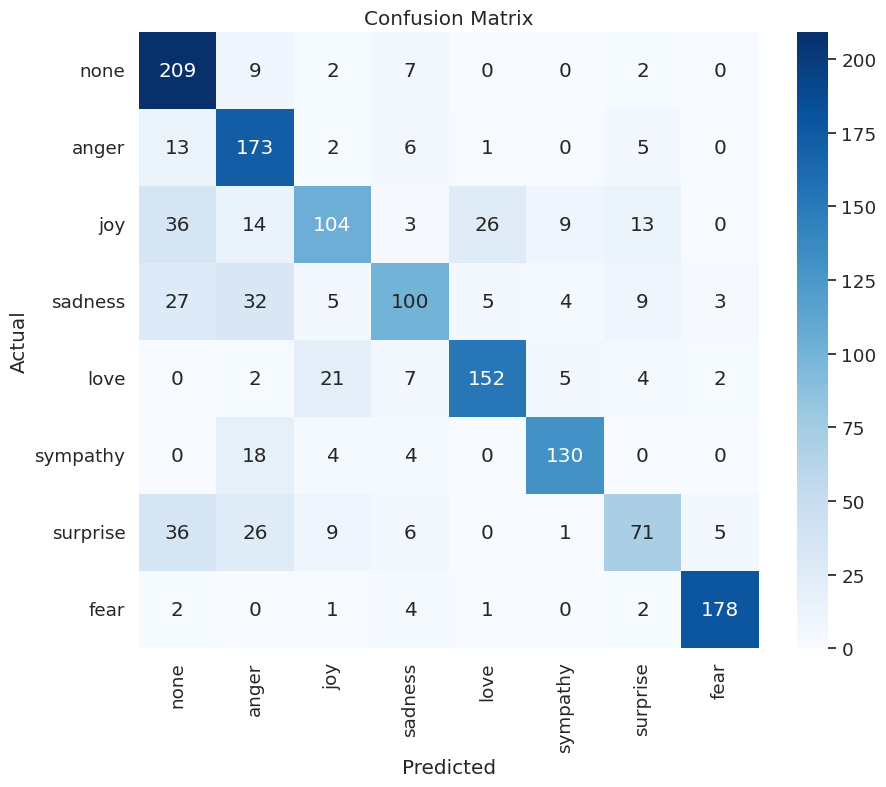

In [26]:
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

cm = confusion_matrix(X_test['label'], test_pred)

plt.figure(figsize=(10, 8))
sns.set(font_scale=1.2)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=classes, yticklabels=classes)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

####Train Data

In [27]:
from torch.utils.data import TensorDataset, DataLoader

input_ids = [i['input_ids'] for i in X_train]
attention_masks = [i['attention_mask'] for i in X_train]

inputs = torch.tensor(input_ids)
masks = torch.tensor(attention_masks)
train_data = TensorDataset(inputs, masks)

train_dataloader = DataLoader(train_data, batch_size=batch_size)

In [28]:
from sklearn.metrics import classification_report

model = trainer.model
model.eval()
model.to(device)

train_pred = []
for input, masks in train_dataloader:
    torch.cuda.empty_cache()

    input = input.to(device)
    masks = masks.to(device)

    output = model(input, attention_mask=masks)['logits']
    predictions = torch.argmax(output, dim=1)
    predictions = predictions.cpu().detach().numpy()

    train_pred.extend(predictions)

print(classification_report(X_train['label'], train_pred, target_names=classes))

              precision    recall  f1-score   support

        none       0.73      0.96      0.83      1074
       anger       0.77      0.95      0.85      1019
         joy       0.89      0.75      0.81       891
     sadness       0.87      0.71      0.78       885
        love       0.90      0.91      0.90       850
    sympathy       0.93      0.93      0.93       755
    surprise       0.85      0.56      0.67       729
        fear       0.97      0.95      0.96       842

    accuracy                           0.85      7045
   macro avg       0.86      0.84      0.84      7045
weighted avg       0.86      0.85      0.84      7045



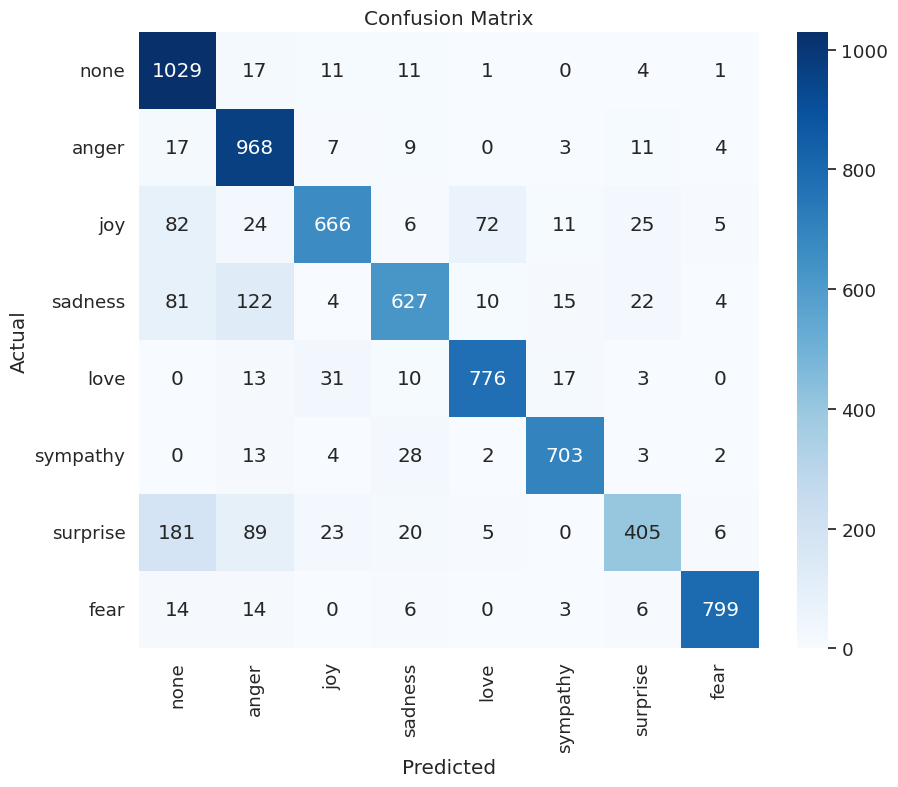

In [29]:
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

cm = confusion_matrix(X_train['label'], train_pred)

plt.figure(figsize=(10, 8))
sns.set(font_scale=1.2)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=classes, yticklabels=classes)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

####Dev Data

In [30]:
from torch.utils.data import TensorDataset, DataLoader

input_ids = [i['input_ids'] for i in X_dev]
attention_masks = [i['attention_mask'] for i in X_dev]

inputs = torch.tensor(input_ids)
masks = torch.tensor(attention_masks)
dev_data = TensorDataset(inputs, masks)

dev_dataloader = DataLoader(dev_data, batch_size=batch_size)

In [31]:
from sklearn.metrics import classification_report

model = trainer.model
model.eval()
model.to(device)

dev_pred = []
for input, masks in dev_dataloader:
    torch.cuda.empty_cache()

    input = input.to(device)
    masks = masks.to(device)

    output = model(input, attention_mask=masks)['logits']
    predictions = torch.argmax(output, dim=1)
    predictions = predictions.cpu().detach().numpy()

    dev_pred.extend(predictions)

print(classification_report(X_dev['label'], dev_pred, target_names=classes))

              precision    recall  f1-score   support

        none       0.65      0.91      0.76       229
       anger       0.63      0.86      0.73       200
         joy       0.70      0.51      0.59       205
     sadness       0.73      0.54      0.62       185
        love       0.82      0.79      0.80       193
    sympathy       0.87      0.83      0.85       156
    surprise       0.67      0.46      0.55       154
        fear       0.95      0.95      0.95       188

    accuracy                           0.74      1510
   macro avg       0.75      0.73      0.73      1510
weighted avg       0.75      0.74      0.73      1510



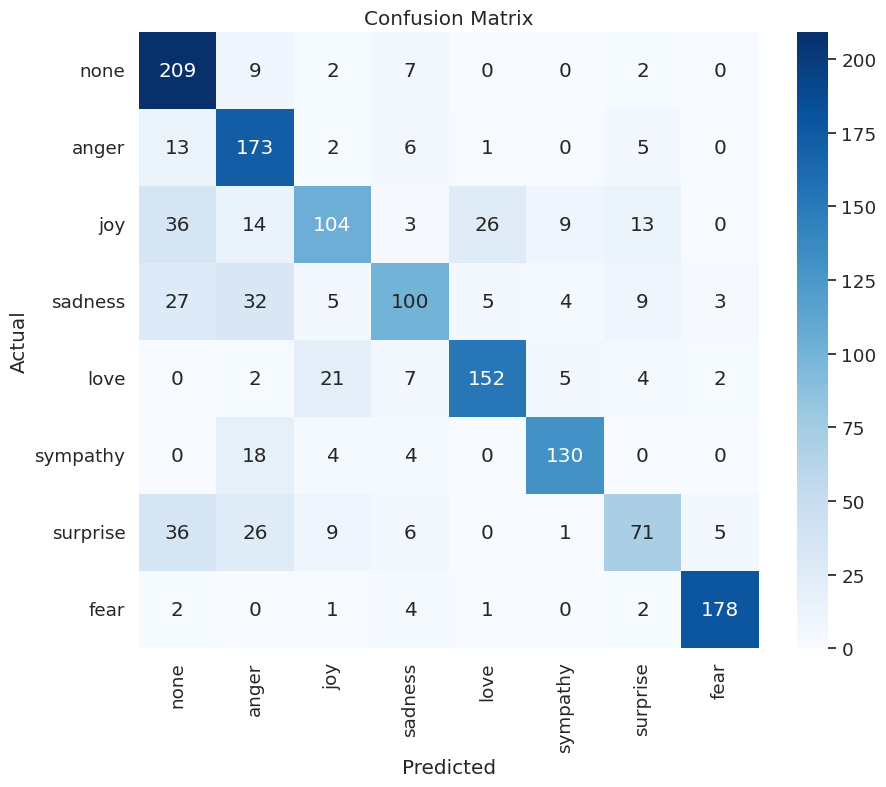

In [33]:
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

cm = confusion_matrix(X_dev['label'], dev_pred)

plt.figure(figsize=(10, 8))
sns.set(font_scale=1.2)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=classes, yticklabels=classes)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

#Samples to Explain

In [ ]:
print(label_to_class)

{0: 'none', 1: 'anger', 2: 'joy', 3: 'sadness', 4: 'love', 5: 'sympathy', 6: 'surprise', 7: 'fear'}


In [ ]:
misclassified_indexes = [89, 669, 161, 12, 317, 1241, 312, 5]
correctly_classified_indexes = [24, 29, 31, 270, 171, 107, 116, 126]

In [ ]:
# misclassified samples
test_pred = np.array(test_pred)
test_true = np.array(X_test['label'])

##Dig Missclassified Examples

In [ ]:
# lets find some misclassified examles
c = 0
for i in range(len(test_pred)):
  if test_pred[i] != test_true[i]:
    sample = X_test['tweet'][i]
    print(f'index: {i}')
    print(f'sample: {sample}')
    print(f'true label {classes[test_true[i]]}')
    print(f'pred label {classes[test_pred[i]]}')
    print("--------------------------------------------------------")
    c += 1
    if c == 30:
      break

index: 0
sample: طب هنعيش ازاي من غير رفع اثقال من هنا لحد الاوليمبياد الجايه بعد 4 سنين...؟؟
true label fear
pred label none
--------------------------------------------------------
index: 5
sample: اعتقال مغربي قتل اسبانيا بشكل مروع | ماذا جري
true label fear
pred label surprise
--------------------------------------------------------
index: 7
sample: NAME?
true label none
pred label surprise
--------------------------------------------------------
index: 8
sample: النرويج تهدي  فنلندا جبلًا في عيد استقلالها     اسال اكثر
true label joy
pred label surprise
--------------------------------------------------------
index: 12
sample: المصريين داخلين الاوليمبياد تمثيل مشرف
true label sadness
pred label none
--------------------------------------------------------
index: 14
sample: Mortada حرااااااام الظلم التحكيمي الفاجر ده
true label sadness
pred label anger
--------------------------------------------------------
index: 15
sample: وائل كفوري  عششششششق 🙈 اتمني ان اتخلص منه لادخل الجنه 😢💔

##Dig Correctly Classified Examples

In [ ]:
# lets find some misclassified examles
c = 0
for i in range(len(test_pred)):
  if test_pred[i] == test_true[i]:
    sample = X_test['tweet'][i]
    print(f'index: {i}')
    print(f'sample: {sample}')
    print(f'true label {classes[test_true[i]]}')
    print(f'pred label {classes[test_pred[i]]}')
    print("--------------------------------------------------------")
    c += 1
    if c == 30:
      break

index: 1
sample: tv علي عبدالله صالح صانع الوحده لا تنساء هذا واذكرك ان ازعيم لن يفرط في الوحده لو كلفته حياته. خليهاء في راسك مسمار مسمم
true label anger
pred label anger
--------------------------------------------------------
index: 2
sample: الاوليمبياد السنه دي افشخ من سيدني اللي كنا بنزوغ من المدرسه علشان نتفرج عليها 😀
true label joy
pred label joy
--------------------------------------------------------
index: 3
sample: نفسي اشوف قطري جد جد مشارك في الاوليمبياد نفس الشئ ينطبق علي الفرنسيين
true label none
pred label none
--------------------------------------------------------
index: 4
sample: she3er: سمعت ان الحنين يقصرّ الاعمار ! انا خايف تغيب اكثر و   احتضرك
true label fear
pred label fear
--------------------------------------------------------
index: 6
sample: الارجنتين خرجت من منافسات كره القدم في الاوليمبياد بعد ما اتعادلت مع الهندوراس.. الهندوراس اتاهلت بفرق الاهداف  Football
true label none
pred label none
--------------------------------------------------------
index: 

##Find their predictions !

In [ ]:
correct_samples = X_test.to_pandas().loc[correctly_classified_indexes][['tweet', 'Light Stemming', 'label']]
wrong_samples = X_test.to_pandas().loc[misclassified_indexes][['tweet', 'Light Stemming', 'label']]

In [ ]:
correct_samples

,tweet,Light Stemming,label
24,هو في كام قطري في بعثه قطر في الاوليمبياد؟,كام قطري بعثه قطر الاوليمبياد,0
29,هو الواد محمد هاني ده مقموص من حاجه!! يعني جي ...,الواد محمد هاني مقموص حاجه جي يلعب غصب ببلاش م...,1
31,صوتك ده ايه الله عليه ملايكه بيغنوا ...,صوتك الله ملايكه بيغن,2
270,: حتي اقرب الشخاص ~ يخذلوننا ~ وما اقساها من ...,اقرب الشخاص يخذلون اقسا خيبه حزن,3
171,انا بقربگ اعيش الهنا 💋💕🍃,بقربگ اعيش اله حب حب,4
107,ذوي الاحتياجات فئه يجب ان تذلل لهم جميع العقبا...,الاحتياج فئه يجب تذلل العقب الله عون,5
116,ده كل لما مصر تفتح معبر يحصل تفجير كل دي صدف؟,مصر تفتح معبر يحصل تفجير صدف,6
126,انا كل الي خايفه منه ان يطلع عندي امتحان بكره ...,خايفه يطلع امتح بكره معرفش,7


In [ ]:
wrong_samples

,tweet,Light Stemming,label
89,دخله الاوليمبياد دي بتفكرني بالاسبوع الثقافي ا...,دخله الاوليمبياد بتفكر بالاسبوع الثقافي حب,0
669,همسكهم الاتنين و اخبطهم في حيطه و نبدا علي نضيف,همسك الاتن اخبط حيطه نبدا نضيف,1
161,نقطه ضعف الشاب العيون الجميله...,نقطه ضعف الشاب العي الجميله,2
12,المصريين داخلين الاوليمبياد تمثيل مشرف,المصر داخل الاوليمبياد تمثيل مشرف,3
317,اليوم الل مش بشوفها فيه بيبقا يوم كئيب اوي 👼❤❤,اليوم مش بشوف بيبقا يوم كئيب اوي حب حب,4
1241,حسبنا الله ونعم الوكيل حلب..حيث تذبح الطفول,الله الوكيل حلب تذبح الطفول,5
312,وزاره التعليم مش عايزين ياجلوا امتحانات البنت ...,وزاره التعليم مش عايز ياجل امتحان البنت الاولي...,6
5,اعتقال مغربي قتل اسبانيا بشكل مروع | ماذا جري,اعتقال مغربي قتل اسبان بشكل مروع جري,7


In [ ]:
correct_samples = correct_samples.rename_axis('id')
correct_samples = correct_samples.reset_index(drop=True)
correct_samples = Dataset.from_pandas(correct_samples)

wrong_samples = wrong_samples.rename_axis('id')
wrong_samples = wrong_samples.reset_index(drop=True)
wrong_samples = Dataset.from_pandas(wrong_samples)

In [ ]:
correct_samples = correct_samples.map(tokenize_function, batched=True, num_proc = 8)
wrong_samples = wrong_samples.map(tokenize_function, batched=True, num_proc = 8)

Map (num_proc=8):   0%|          | 0/8 [00:00<?, ? examples/s]

Map (num_proc=8):   0%|          | 0/8 [00:00<?, ? examples/s]

In [ ]:
from torch.utils.data import TensorDataset, DataLoader

input_ids = [i['input_ids'] for i in wrong_samples]
attention_masks = [i['attention_mask'] for i in wrong_samples]

samples_inputs = torch.tensor(input_ids)
samples_masks = torch.tensor(attention_masks)
sample_data = TensorDataset(samples_inputs, samples_masks)

samples_dataloader = DataLoader(sample_data)

In [ ]:
from sklearn.metrics import classification_report

wrong_outputs = []

model.eval()
for input, masks in samples_dataloader:
    torch.cuda.empty_cache()

    input = input.to(device)
    masks = masks.to(device)

    output = model(input, attention_mask=masks)['logits']
    predictions = torch.argmax(output, dim=1)
    predictions = predictions.cpu().detach().numpy()

    wrong_outputs.extend(predictions)

# true labels for the misclassified samples
true_labels = X_test.to_pandas().loc[misclassified_indexes]['label'].values.tolist()

In [ ]:
correct_outputs = [0, 1, 2, 3, 4, 5, 6, 7]
classes, true_labels, wrong_outputs, correct_outputs

(['none', 'anger', 'joy', 'sadness', 'love', 'sympathy', 'surprise', 'fear'],
 [0, 1, 2, 3, 4, 5, 6, 7],
 [2, 2, 3, 0, 6, 1, 0, 6],
 [0, 1, 2, 3, 4, 5, 6, 7])

#Explainable AI XAI

In [ ]:
def print_sample(index, wrong):

  if wrong:
    samples = wrong_samples
    outputs = wrong_outputs
  else:
    samples = correct_samples
    outputs = correct_outputs

  original_sample = samples['tweet'][index]
  preprocs_sample = samples['Light Stemming'][index]
  true_label = classes[samples['label'][index]]
  pred_label = classes[outputs[index]]
  print(f'tweet: {original_sample}, true label: {true_label}')
  print(f'light: {preprocs_sample}, pred label: {pred_label}')

  return preprocs_sample

##Pipeline

In [65]:
from transformers import pipeline

# build a pipeline object to do predictions
pred = pipeline("text-classification", model=model, tokenizer=tokenizer, device=device, top_k=None, return_all_scores=True)

Xformers is not installed correctly. If you want to use memory_efficient_attention to accelerate training use the following command to install Xformers
pip install xformers.
The model 'LRPBertForSequenceClassification' is not supported for text-classification. Supported models are ['AlbertForSequenceClassification', 'BartForSequenceClassification', 'BertForSequenceClassification', 'BigBirdForSequenceClassification', 'BigBirdPegasusForSequenceClassification', 'BioGptForSequenceClassification', 'BloomForSequenceClassification', 'CamembertForSequenceClassification', 'CanineForSequenceClassification', 'ConvBertForSequenceClassification', 'CTRLForSequenceClassification', 'Data2VecTextForSequenceClassification', 'DebertaForSequenceClassification', 'DebertaV2ForSequenceClassification', 'DistilBertForSequenceClassification', 'ElectraForSequenceClassification', 'ErnieForSequenceClassification', 'ErnieMForSequenceClassification', 'EsmForSequenceClassification', 'FalconForSequenceClassification',

##SHAP

In [66]:
import shap

shap.initjs()
shap_explainer = shap.Explainer(pred, output_names=classes)

In [64]:
from shap.plots import waterfall, bar
def show_plots(prediction, index, wrong, plot='waterfall', max_display=None):

  if wrong:
    samples = wrong_samples
  else:
    samples = correct_samples

  print_sample(index, wrong)

  sv = shap_explainer(samples['Light Stemming'])
  show = sv[index, :, prediction]

  if plot == 'waterfall':
    if max_display is not None:
      waterfall(show, max_display=max_display)
    else:
      waterfall(show)
  elif plot == 'bar':
    if max_display is not None:
      bar(show, max_display=max_display)
    else:
      bar(show)

###Waterfall Plot

####Misclassified

tweet: دخله الاوليمبياد دي بتفكرني بالاسبوع الثقافي اللي كان عندنا 😍, true label: none
light: دخله الاوليمبياد بتفكر بالاسبوع الثقافي حب, pred label: joy


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
Partition explainer: 9it [00:17,  3.53s/it]


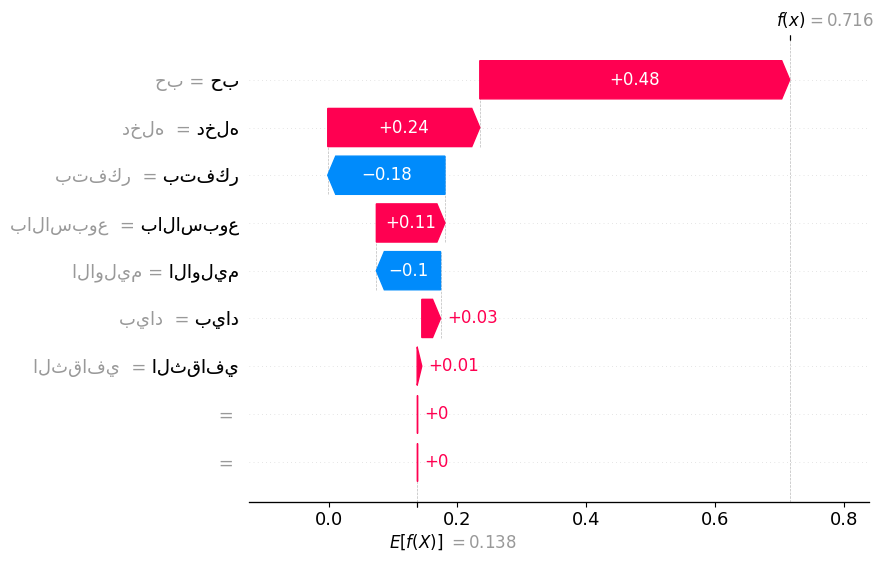

tweet: همسكهم الاتنين و اخبطهم في حيطه و نبدا علي نضيف, true label: anger
light: همسك الاتن اخبط حيطه نبدا نضيف, pred label: joy


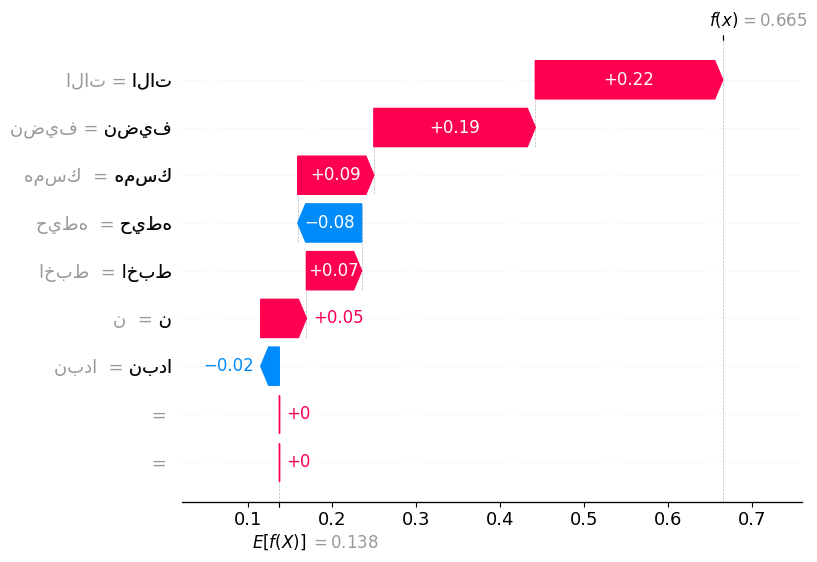

tweet: نقطه ضعف الشاب العيون الجميله..., true label: joy
light: نقطه ضعف الشاب العي الجميله, pred label: sadness


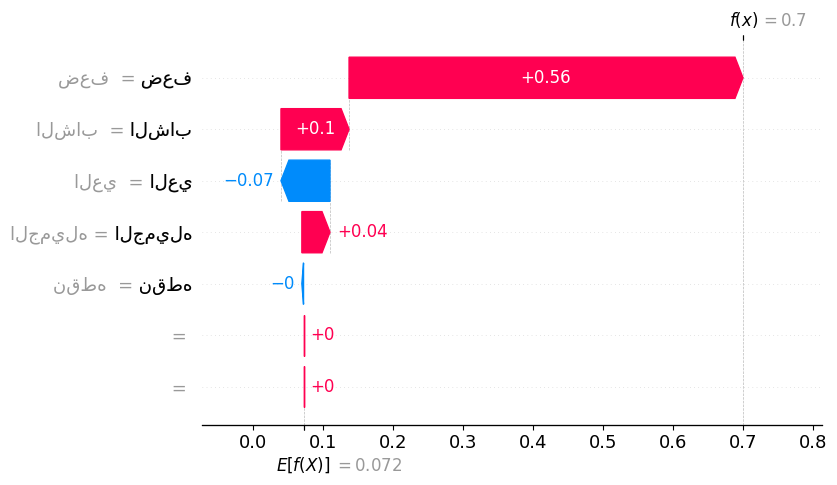

tweet: المصريين داخلين الاوليمبياد تمثيل مشرف, true label: sadness
light: المصر داخل الاوليمبياد تمثيل مشرف, pred label: none


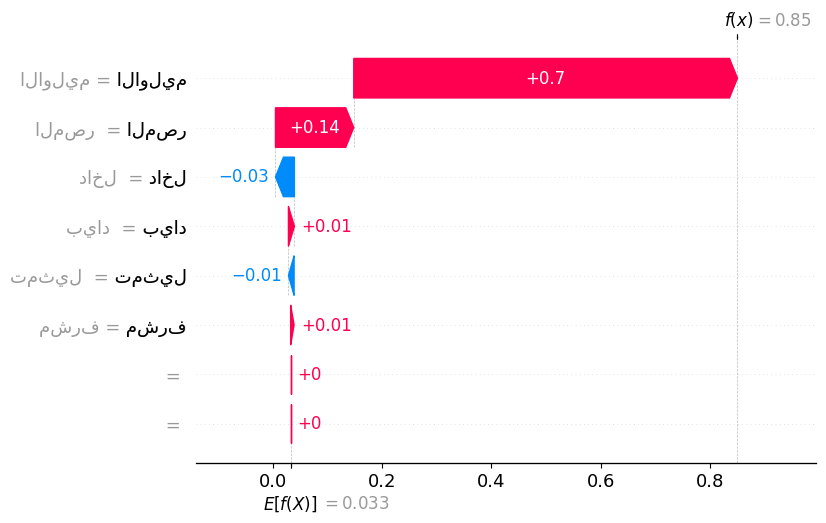

tweet: اليوم الل مش بشوفها فيه بيبقا يوم كئيب اوي 👼❤❤, true label: love
light: اليوم مش بشوف بيبقا يوم كئيب اوي حب حب, pred label: surprise


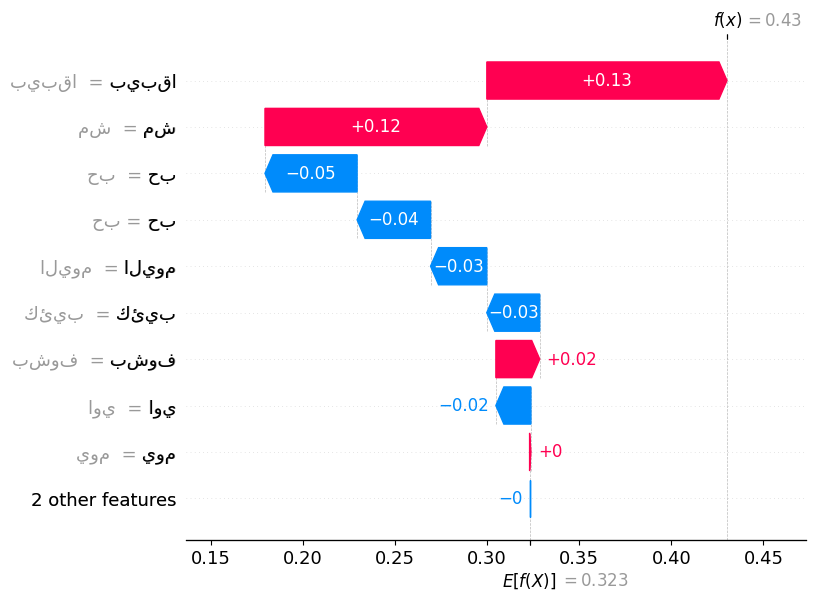

tweet: حسبنا الله ونعم الوكيل حلب..حيث تذبح الطفول, true label: sympathy
light: الله الوكيل حلب تذبح الطفول, pred label: anger


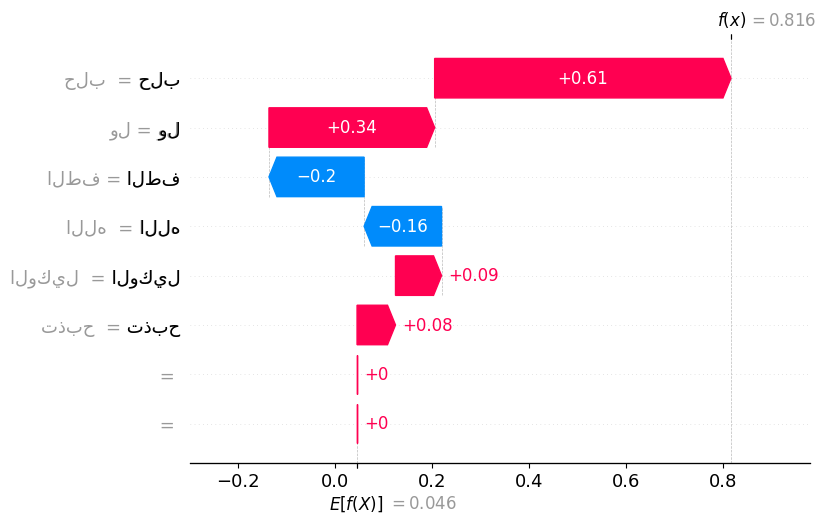

tweet: وزاره التعليم مش عايزين ياجلوا امتحانات البنت اللي في الاوليمبياد؟ حد يقدر ياكد او ينفي؟, true label: surprise
light: وزاره التعليم مش عايز ياجل امتحان البنت الاوليمبياد يقدر ياكد ينفي, pred label: none


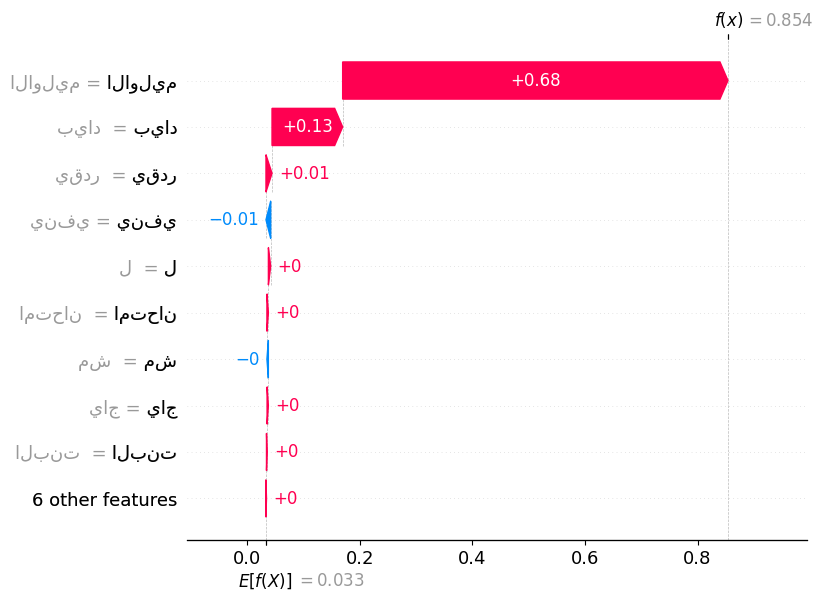

tweet: اعتقال مغربي قتل اسبانيا بشكل مروع | ماذا جري, true label: fear
light: اعتقال مغربي قتل اسبان بشكل مروع جري, pred label: surprise


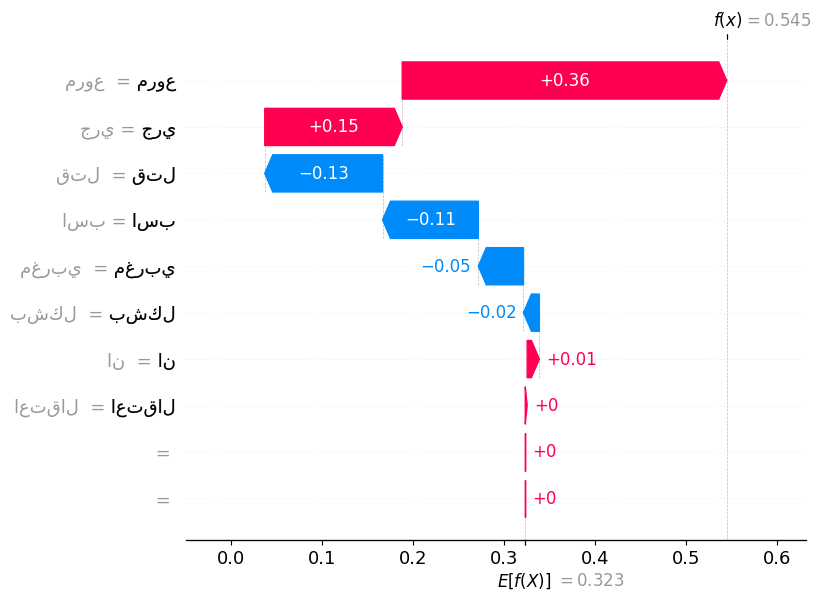

In [ ]:
for index in range(8):
  show_plots(np.array(wrong_outputs)[index], index, wrong=True, plot='waterfall')

####Correctly Classified

tweet: هو في كام قطري في بعثه قطر في الاوليمبياد؟, true label: none
light: كام قطري بعثه قطر الاوليمبياد, pred label: none


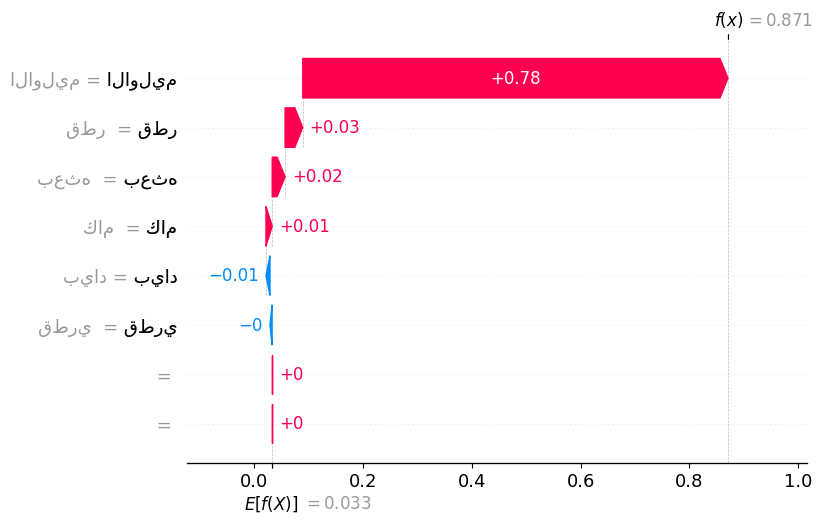

tweet: هو الواد محمد هاني ده مقموص من حاجه!! يعني جي يلعب غصب عنه او ببلاش مثلا..!!  الاهلي, true label: anger
light: الواد محمد هاني مقموص حاجه جي يلعب غصب ببلاش مثلا الاهلي, pred label: anger


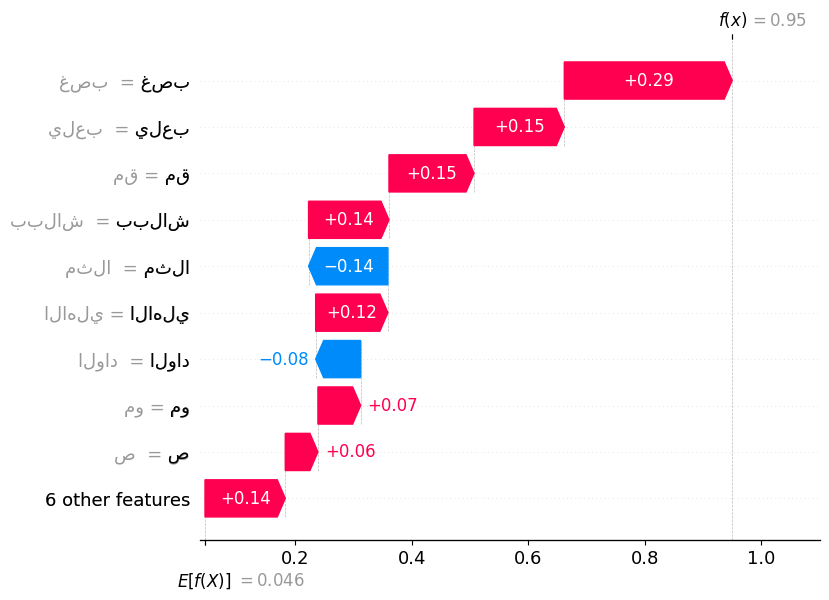

tweet: صوتك ده ايه الله عليه ملايكه بيغنوا ..., true label: joy
light: صوتك الله ملايكه بيغن, pred label: joy


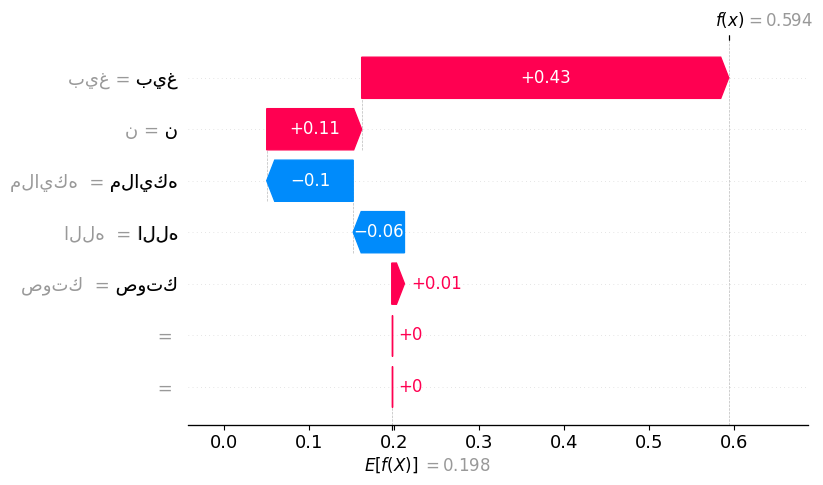

tweet: : حتي اقرب الشخاص ~ يخذلوننا ~ وما اقساها من  خيبه.. 💔, true label: sadness
light: اقرب الشخاص يخذلون اقسا خيبه حزن, pred label: sadness


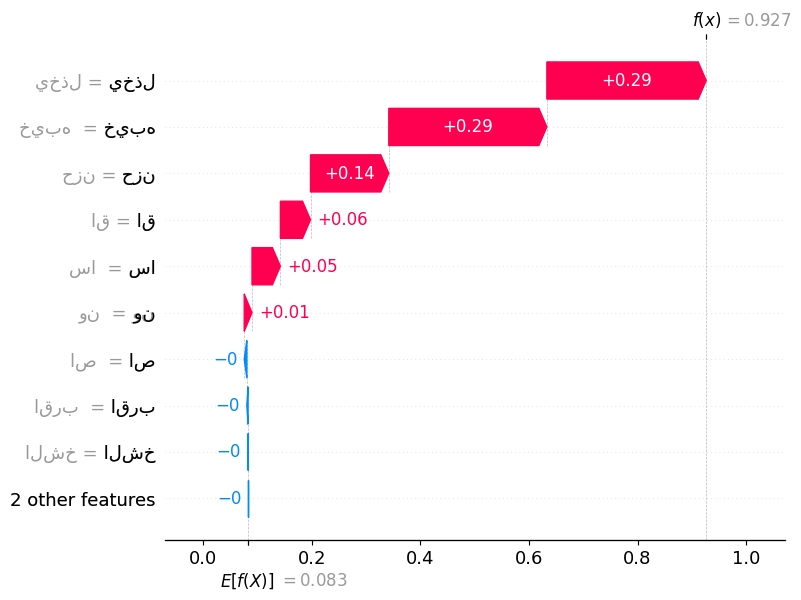

tweet: انا بقربگ اعيش الهنا 💋💕🍃, true label: love
light: بقربگ اعيش اله حب حب, pred label: love


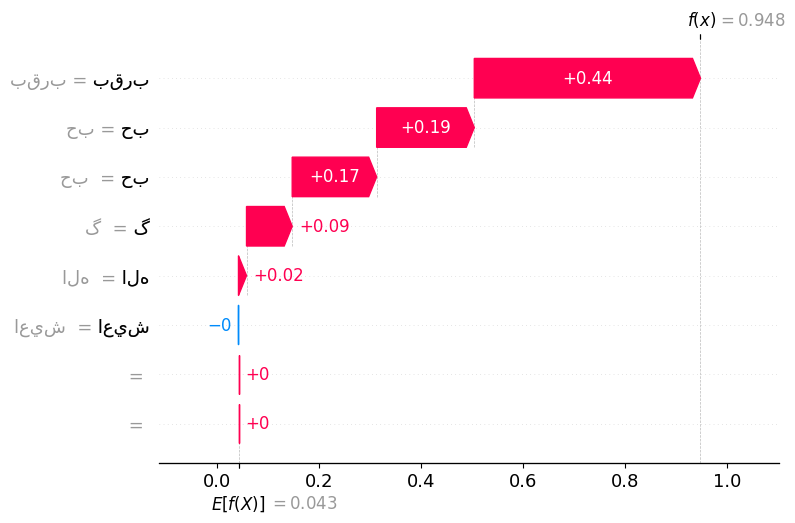

tweet: ذوي الاحتياجات فئه يجب ان تذلل لهم جميع العقبات كان الله في عونهم ., true label: sympathy
light: الاحتياج فئه يجب تذلل العقب الله عون, pred label: sympathy


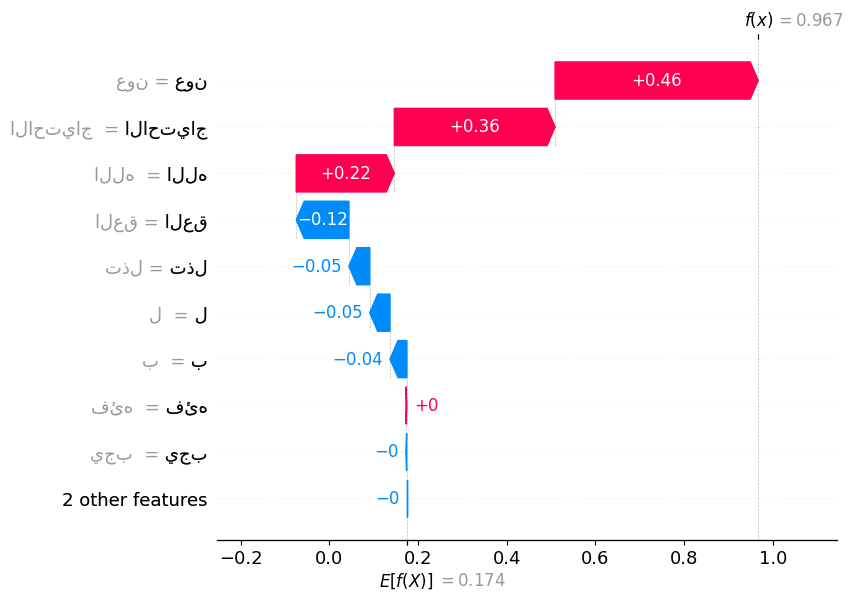

tweet: ده كل لما مصر تفتح معبر يحصل تفجير كل دي صدف؟, true label: surprise
light: مصر تفتح معبر يحصل تفجير صدف, pred label: surprise


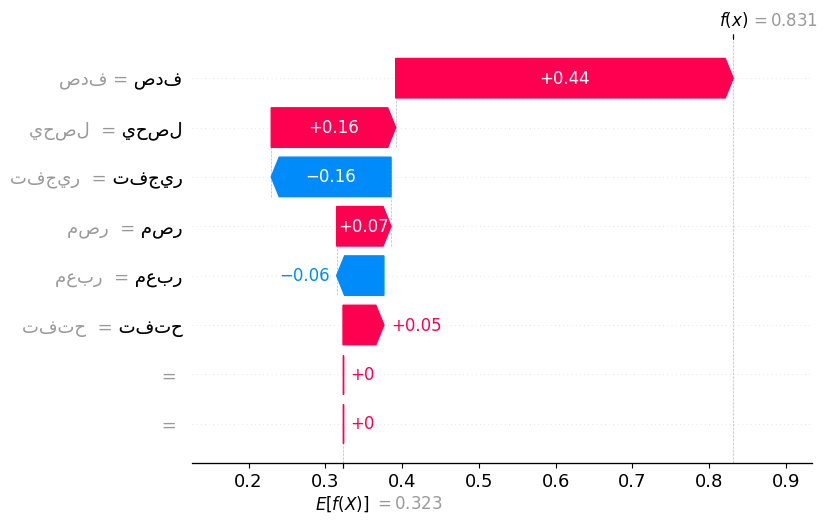

tweet: انا كل الي خايفه منه ان يطلع عندي امتحان بكره وانا معرفش..., true label: fear
light: خايفه يطلع امتح بكره معرفش, pred label: fear


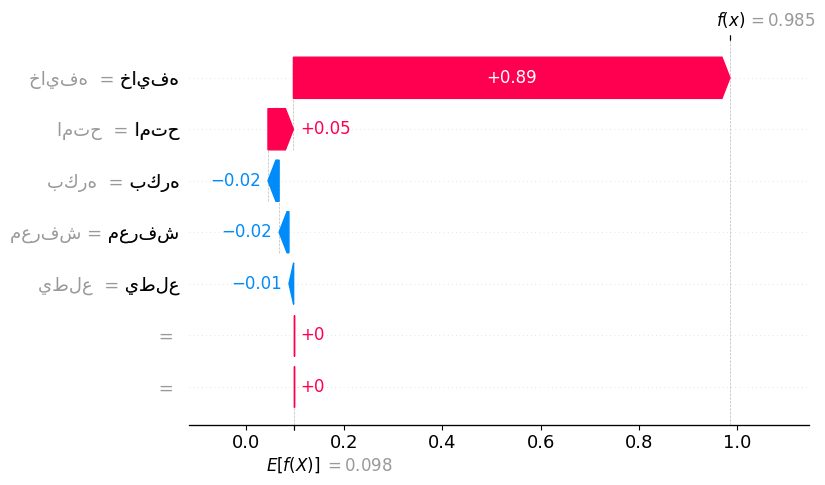

In [ ]:
for index in range(8):
  show_plots(np.array(correct_outputs)[index], index, wrong=False, plot='waterfall')

###Bar Plot

####Misclassified

tweet: دخله الاوليمبياد دي بتفكرني بالاسبوع الثقافي اللي كان عندنا 😍, true label: none
light: دخله الاوليمبياد بتفكر بالاسبوع الثقافي حب, pred label: joy


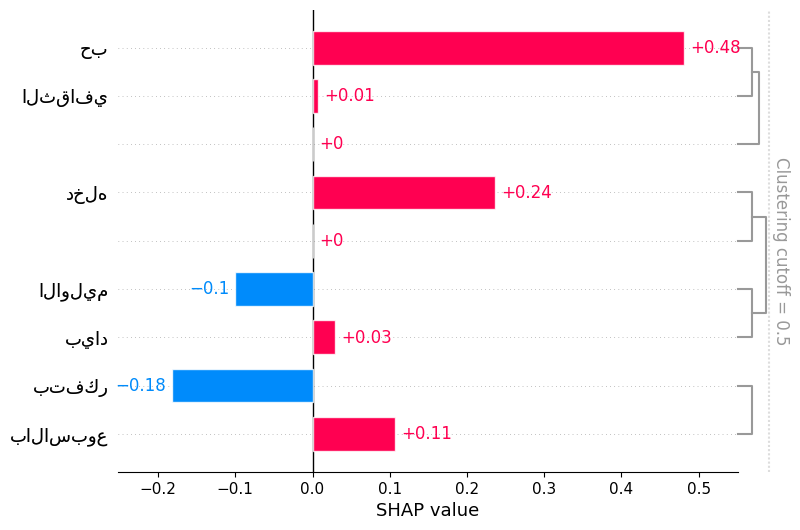

tweet: همسكهم الاتنين و اخبطهم في حيطه و نبدا علي نضيف, true label: anger
light: همسك الاتن اخبط حيطه نبدا نضيف, pred label: joy


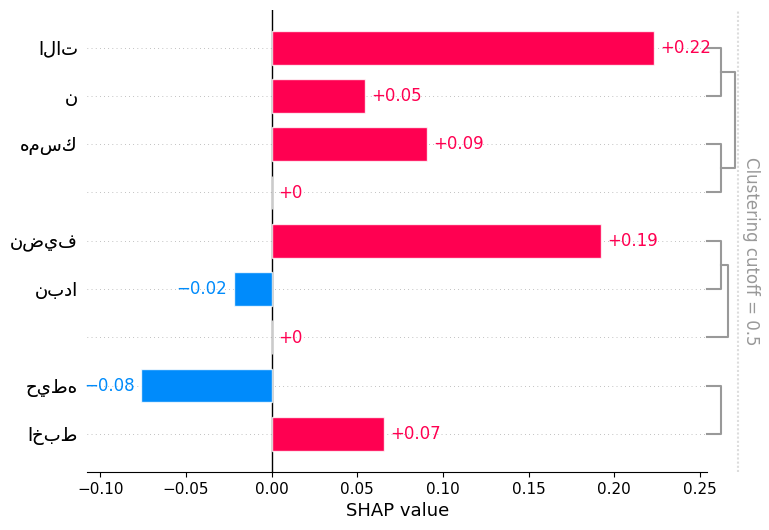

tweet: نقطه ضعف الشاب العيون الجميله..., true label: joy
light: نقطه ضعف الشاب العي الجميله, pred label: sadness


Partition explainer: 9it [00:10, 10.81s/it]               


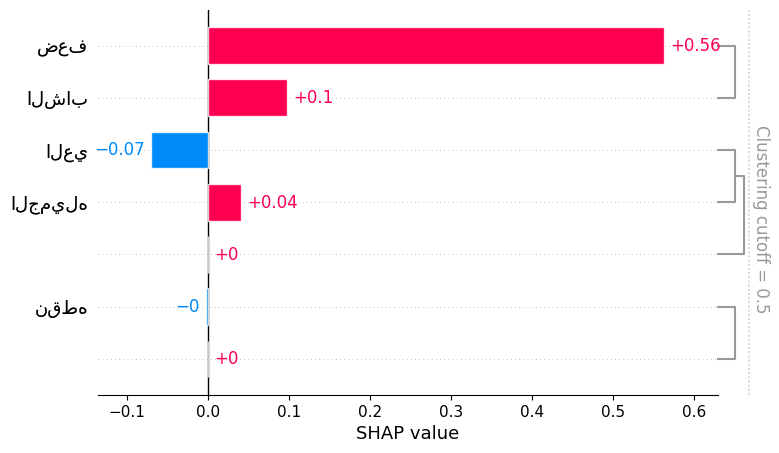

tweet: المصريين داخلين الاوليمبياد تمثيل مشرف, true label: sadness
light: المصر داخل الاوليمبياد تمثيل مشرف, pred label: none


Partition explainer: 9it [00:11,  5.89s/it]


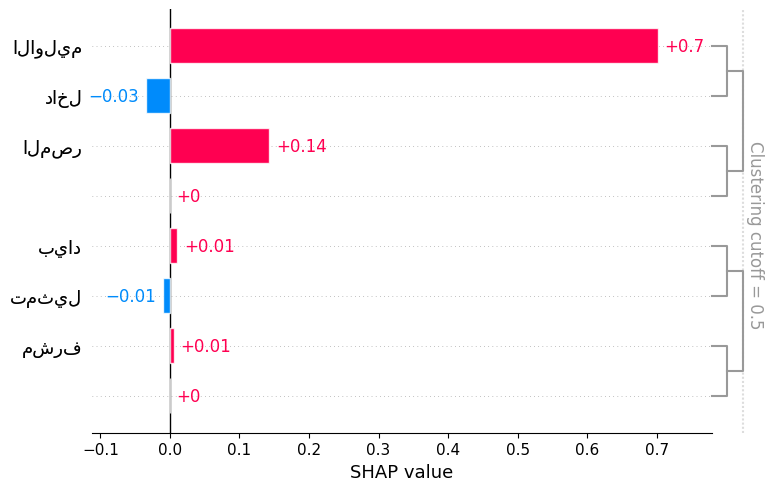

tweet: اليوم الل مش بشوفها فيه بيبقا يوم كئيب اوي 👼❤❤, true label: love
light: اليوم مش بشوف بيبقا يوم كئيب اوي حب حب, pred label: surprise


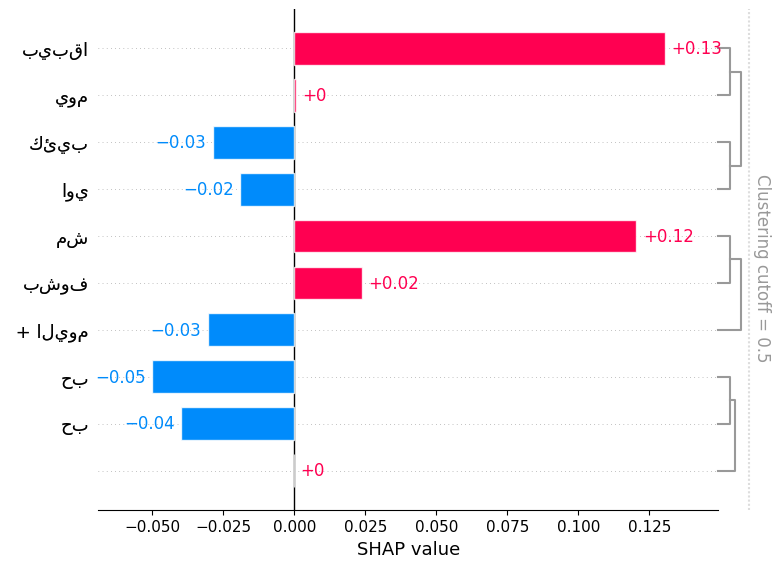

tweet: حسبنا الله ونعم الوكيل حلب..حيث تذبح الطفول, true label: sympathy
light: الله الوكيل حلب تذبح الطفول, pred label: anger


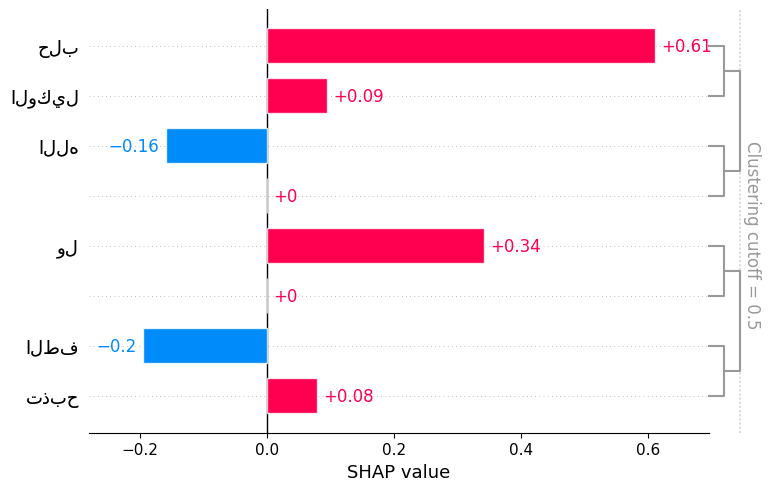

tweet: وزاره التعليم مش عايزين ياجلوا امتحانات البنت اللي في الاوليمبياد؟ حد يقدر ياكد او ينفي؟, true label: surprise
light: وزاره التعليم مش عايز ياجل امتحان البنت الاوليمبياد يقدر ياكد ينفي, pred label: none


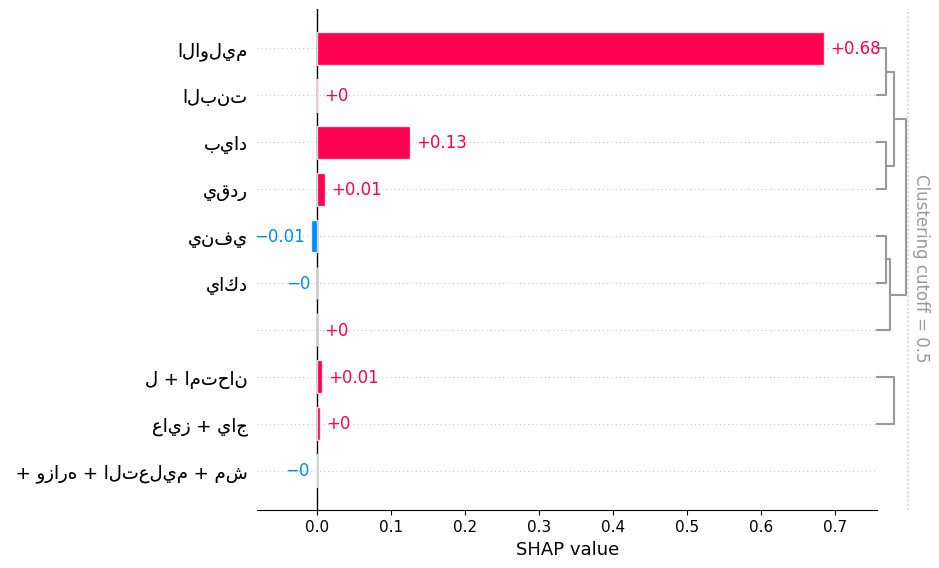

tweet: اعتقال مغربي قتل اسبانيا بشكل مروع | ماذا جري, true label: fear
light: اعتقال مغربي قتل اسبان بشكل مروع جري, pred label: surprise


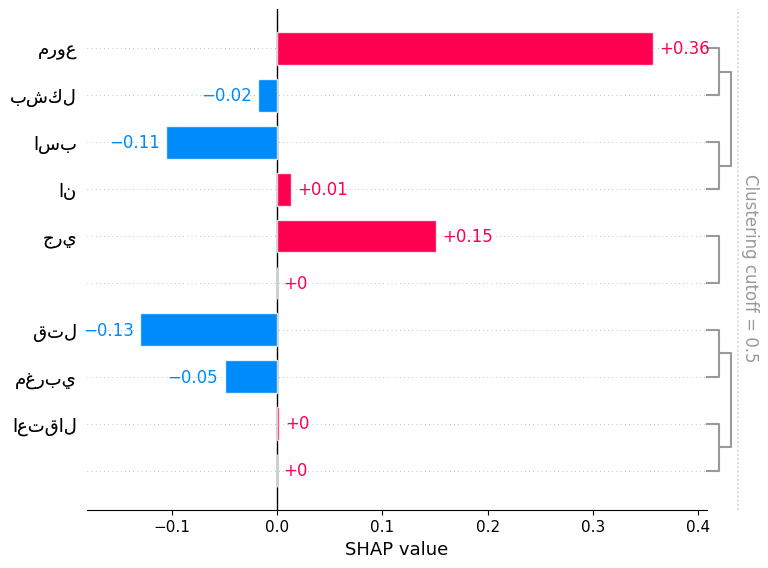

In [ ]:
for index in range(8):
  show_plots(np.array(wrong_outputs)[index], index, wrong=True, plot='bar')

####Correctly Classified

tweet: هو في كام قطري في بعثه قطر في الاوليمبياد؟, true label: none
light: كام قطري بعثه قطر الاوليمبياد, pred label: none


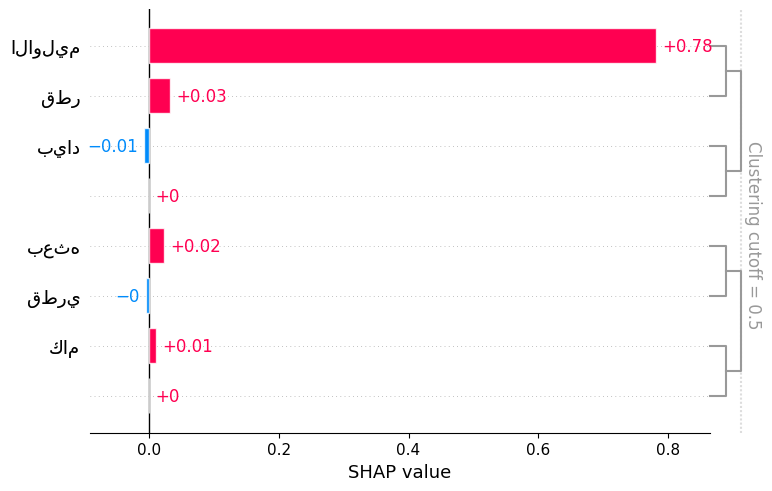

tweet: هو الواد محمد هاني ده مقموص من حاجه!! يعني جي يلعب غصب عنه او ببلاش مثلا..!!  الاهلي, true label: anger
light: الواد محمد هاني مقموص حاجه جي يلعب غصب ببلاش مثلا الاهلي, pred label: anger


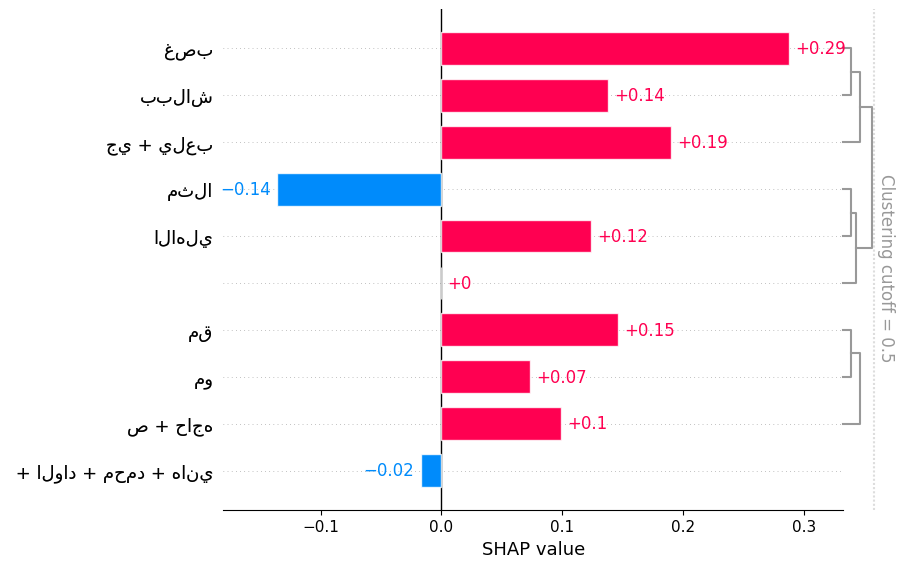

tweet: صوتك ده ايه الله عليه ملايكه بيغنوا ..., true label: joy
light: صوتك الله ملايكه بيغن, pred label: joy


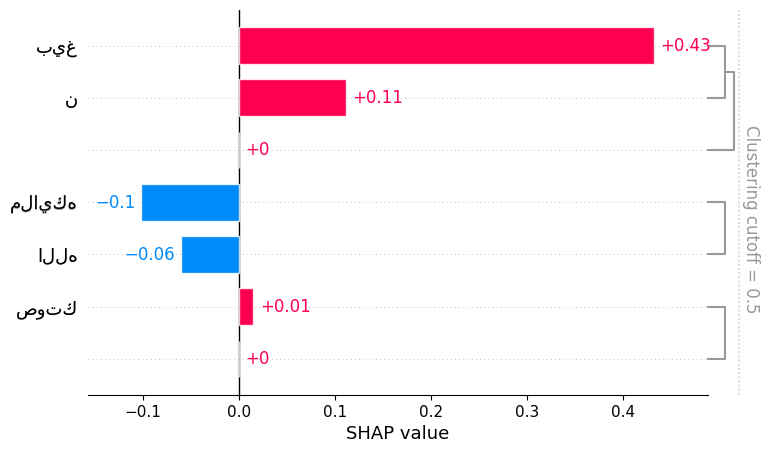

tweet: : حتي اقرب الشخاص ~ يخذلوننا ~ وما اقساها من  خيبه.. 💔, true label: sadness
light: اقرب الشخاص يخذلون اقسا خيبه حزن, pred label: sadness


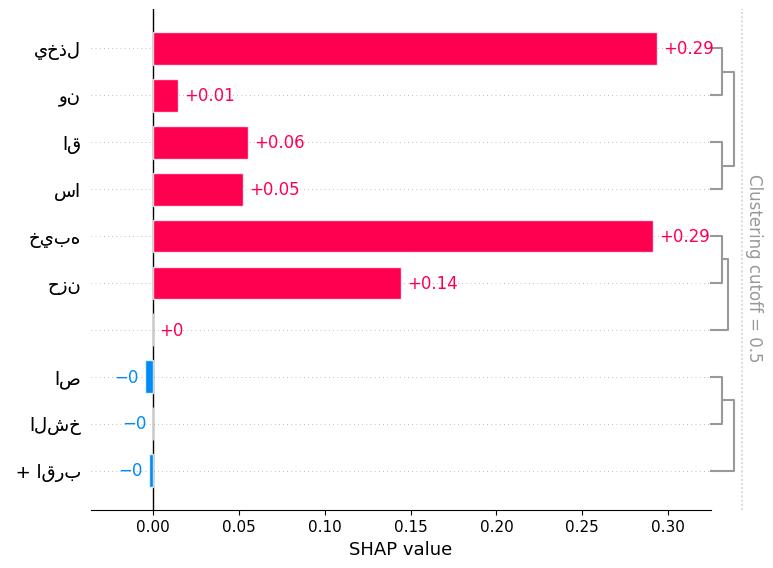

tweet: انا بقربگ اعيش الهنا 💋💕🍃, true label: love
light: بقربگ اعيش اله حب حب, pred label: love


Partition explainer: 9it [00:11,  5.85s/it]


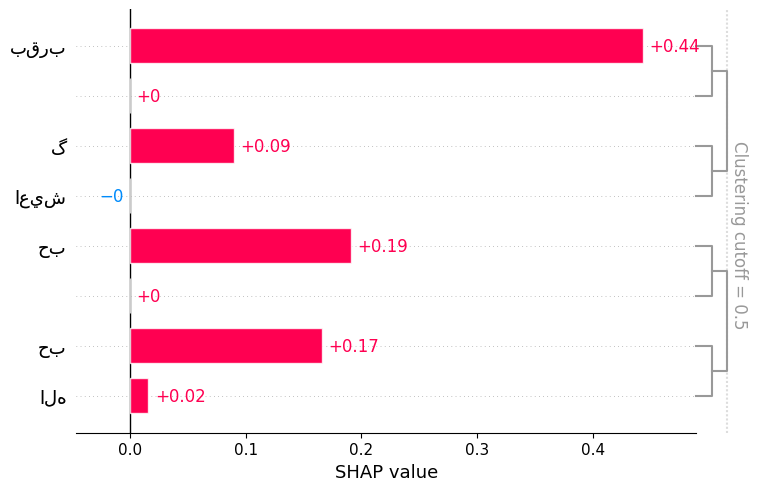

tweet: ذوي الاحتياجات فئه يجب ان تذلل لهم جميع العقبات كان الله في عونهم ., true label: sympathy
light: الاحتياج فئه يجب تذلل العقب الله عون, pred label: sympathy


Partition explainer: 9it [00:11,  5.69s/it]


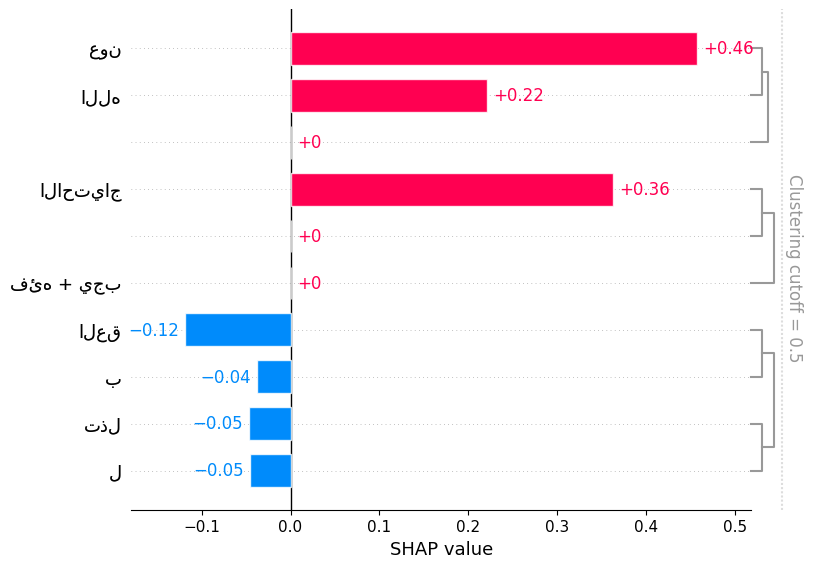

tweet: ده كل لما مصر تفتح معبر يحصل تفجير كل دي صدف؟, true label: surprise
light: مصر تفتح معبر يحصل تفجير صدف, pred label: surprise


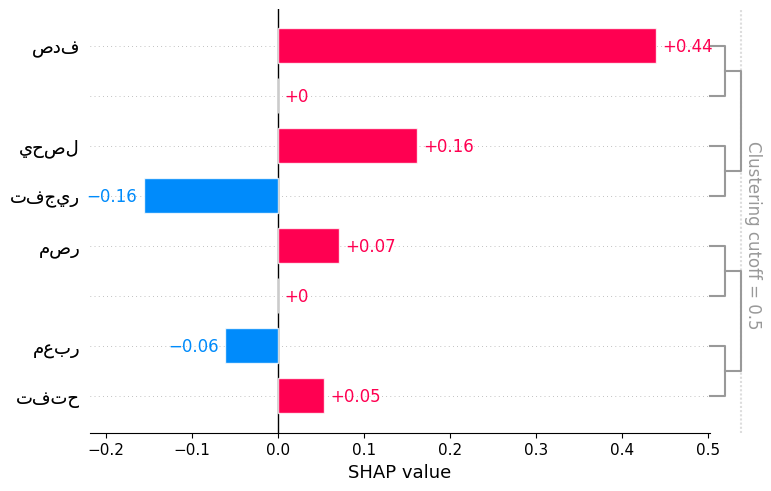

tweet: انا كل الي خايفه منه ان يطلع عندي امتحان بكره وانا معرفش..., true label: fear
light: خايفه يطلع امتح بكره معرفش, pred label: fear


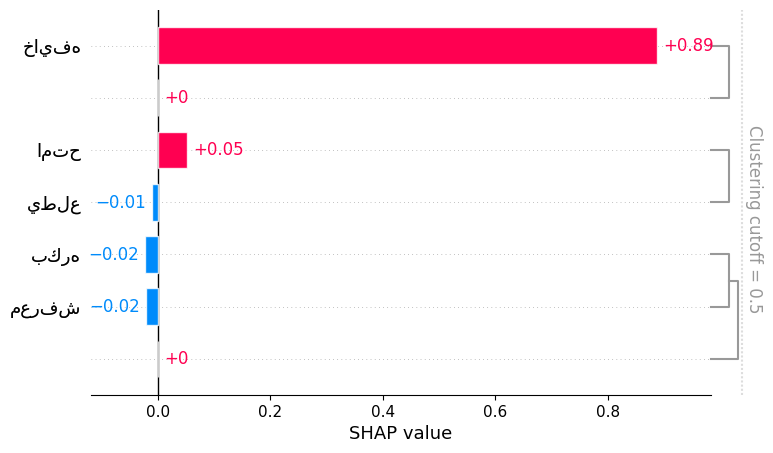

In [ ]:
for index in range(8):
  show_plots(np.array(correct_outputs)[index], index, wrong=False, plot='bar')

##LIME

In [71]:
def predict_proba(tweets):
  output = []
  for tweet in tweets:
    result = pred(tweet)[0]
    scores = [x["score"] for x in result]
    labels = [x["label"] for x in result]
    output.append(np.array([x for _, x in sorted(zip(labels, scores))]).reshape(1,-1))
  return np.array(output).squeeze()

In [ ]:
from lime.lime_text import LimeTextExplainer

def show_lime(index, wrong):

  preprocs_sample = print_sample(index, wrong)
  if wrong:
    p = np.array(wrong_outputs)[index]
  else:
    p = np.array(correct_outputs)[index]
  prediction = (p,)

  exp = lime_explainer.explain_instance(preprocs_sample, predict_proba, labels=prediction)
  exp.show_in_notebook()

lime_explainer = LimeTextExplainer(class_names=classes)

###Misclassified

In [ ]:
for index in range(8):
  show_lime(index, wrong=True)

tweet: دخله الاوليمبياد دي بتفكرني بالاسبوع الثقافي اللي كان عندنا 😍, true label: none
light: دخله الاوليمبياد بتفكر بالاسبوع الثقافي حب, pred label: joy


tweet: همسكهم الاتنين و اخبطهم في حيطه و نبدا علي نضيف, true label: anger
light: همسك الاتن اخبط حيطه نبدا نضيف, pred label: joy


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: نقطه ضعف الشاب العيون الجميله..., true label: joy
light: نقطه ضعف الشاب العي الجميله, pred label: sadness


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: المصريين داخلين الاوليمبياد تمثيل مشرف, true label: sadness
light: المصر داخل الاوليمبياد تمثيل مشرف, pred label: none


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: اليوم الل مش بشوفها فيه بيبقا يوم كئيب اوي 👼❤❤, true label: love
light: اليوم مش بشوف بيبقا يوم كئيب اوي حب حب, pred label: surprise


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: حسبنا الله ونعم الوكيل حلب..حيث تذبح الطفول, true label: sympathy
light: الله الوكيل حلب تذبح الطفول, pred label: anger


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: وزاره التعليم مش عايزين ياجلوا امتحانات البنت اللي في الاوليمبياد؟ حد يقدر ياكد او ينفي؟, true label: surprise
light: وزاره التعليم مش عايز ياجل امتحان البنت الاوليمبياد يقدر ياكد ينفي, pred label: none


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: اعتقال مغربي قتل اسبانيا بشكل مروع | ماذا جري, true label: fear
light: اعتقال مغربي قتل اسبان بشكل مروع جري, pred label: surprise


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


###Correctly Classified

In [ ]:
for index in range(8):
  show_lime(index, wrong=False)

tweet: هو في كام قطري في بعثه قطر في الاوليمبياد؟, true label: none
light: كام قطري بعثه قطر الاوليمبياد, pred label: none


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: هو الواد محمد هاني ده مقموص من حاجه!! يعني جي يلعب غصب عنه او ببلاش مثلا..!!  الاهلي, true label: anger
light: الواد محمد هاني مقموص حاجه جي يلعب غصب ببلاش مثلا الاهلي, pred label: anger


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: صوتك ده ايه الله عليه ملايكه بيغنوا ..., true label: joy
light: صوتك الله ملايكه بيغن, pred label: joy


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: : حتي اقرب الشخاص ~ يخذلوننا ~ وما اقساها من  خيبه.. 💔, true label: sadness
light: اقرب الشخاص يخذلون اقسا خيبه حزن, pred label: sadness


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: انا بقربگ اعيش الهنا 💋💕🍃, true label: love
light: بقربگ اعيش اله حب حب, pred label: love


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: ذوي الاحتياجات فئه يجب ان تذلل لهم جميع العقبات كان الله في عونهم ., true label: sympathy
light: الاحتياج فئه يجب تذلل العقب الله عون, pred label: sympathy


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: ده كل لما مصر تفتح معبر يحصل تفجير كل دي صدف؟, true label: surprise
light: مصر تفتح معبر يحصل تفجير صدف, pred label: surprise


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: انا كل الي خايفه منه ان يطلع عندي امتحان بكره وانا معرفش..., true label: fear
light: خايفه يطلع امتح بكره معرفش, pred label: fear


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


##Tranformers Interpret

In [ ]:
from transformers_interpret import SequenceClassificationExplainer

cls_explainer = SequenceClassificationExplainer(model=model, tokenizer=tokenizer, custom_labels=classes)

def interpret_transformer(wrong):
  if wrong:
    samples = wrong_samples
  else:
    samples = correct_samples

  for index in range(8):
      preprocs_sample = print_sample(index, wrong)
      attributions = cls_explainer(preprocs_sample)
      html = cls_explainer.visualize()

###Misclassified

In [ ]:
interpret_transformer(wrong=True)

tweet: دخله الاوليمبياد دي بتفكرني بالاسبوع الثقافي اللي كان عندنا 😍, true label: none
light: دخله الاوليمبياد بتفكر بالاسبوع الثقافي حب, pred label: joy


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
2,joy (0.68),joy,0.22,[CLS] دخله الاوليم ##بياد بتفكر بالاسبوع الثقافي حب [SEP]


tweet: همسكهم الاتنين و اخبطهم في حيطه و نبدا علي نضيف, true label: anger
light: همسك الاتن اخبط حيطه نبدا نضيف, pred label: joy


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
2,joy (0.66),joy,0.60,[CLS] همسك الات ##ن اخبط حيطه نبدا نضيف [SEP]


tweet: نقطه ضعف الشاب العيون الجميله..., true label: joy
light: نقطه ضعف الشاب العي الجميله, pred label: sadness


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
3,sadness (0.71),sadness,1.69,[CLS] نقطه ضعف الشاب العي الجميله [SEP]


tweet: المصريين داخلين الاوليمبياد تمثيل مشرف, true label: sadness
light: المصر داخل الاوليمبياد تمثيل مشرف, pred label: none


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
0,none (0.85),none,1.64,[CLS] المصر داخل الاوليم ##بياد تمثيل مشرف [SEP]


tweet: اليوم الل مش بشوفها فيه بيبقا يوم كئيب اوي 👼❤❤, true label: love
light: اليوم مش بشوف بيبقا يوم كئيب اوي حب حب, pred label: surprise


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
6,surprise (0.43),surprise,0.50,[CLS] اليوم مش بشوف بيبقا يوم كييب اوي حب حب [SEP]


tweet: حسبنا الله ونعم الوكيل حلب..حيث تذبح الطفول, true label: sympathy
light: الله الوكيل حلب تذبح الطفول, pred label: anger


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
1,anger (0.81),anger,1.90,[CLS] الله الوكيل حلب تذبح الطف ##ول [SEP]


tweet: وزاره التعليم مش عايزين ياجلوا امتحانات البنت اللي في الاوليمبياد؟ حد يقدر ياكد او ينفي؟, true label: surprise
light: وزاره التعليم مش عايز ياجل امتحان البنت الاوليمبياد يقدر ياكد ينفي, pred label: none


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
0,none (0.85),none,2.25,[CLS] وزاره التعليم مش عايز ياج ##ل امتحان البنت الاوليم ##بياد يقدر ياكد ينفي [SEP]


tweet: اعتقال مغربي قتل اسبانيا بشكل مروع | ماذا جري, true label: fear
light: اعتقال مغربي قتل اسبان بشكل مروع جري, pred label: surprise


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
6,surprise (0.51),surprise,0.98,[CLS] اعتقال مغربي قتل اسب ##ان بشكل مروع جري [SEP]


###Correctly Classified

In [ ]:
interpret_transformer(wrong=False)

tweet: هو في كام قطري في بعثه قطر في الاوليمبياد؟, true label: none
light: كام قطري بعثه قطر الاوليمبياد, pred label: none


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
0,none (0.87),none,1.64,[CLS] كام قطري بعثه قطر الاوليم ##بياد [SEP]


tweet: هو الواد محمد هاني ده مقموص من حاجه!! يعني جي يلعب غصب عنه او ببلاش مثلا..!!  الاهلي, true label: anger
light: الواد محمد هاني مقموص حاجه جي يلعب غصب ببلاش مثلا الاهلي, pred label: anger


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
1,anger (0.95),anger,2.35,[CLS] الواد محمد هاني مق ##مو ##ص حاجه جي يلعب غصب ببلاش مثلا الاهلي [SEP]


tweet: صوتك ده ايه الله عليه ملايكه بيغنوا ..., true label: joy
light: صوتك الله ملايكه بيغن, pred label: joy


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
2,joy (0.59),joy,0.18,[CLS] صوتك الله ملايكه بيغ ##ن [SEP]


tweet: : حتي اقرب الشخاص ~ يخذلوننا ~ وما اقساها من  خيبه.. 💔, true label: sadness
light: اقرب الشخاص يخذلون اقسا خيبه حزن, pred label: sadness


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
3,sadness (0.93),sadness,1.82,[CLS] اقرب الشخ ##اص يخذل ##ون اق ##سا خيبه حزن [SEP]


tweet: انا بقربگ اعيش الهنا 💋💕🍃, true label: love
light: بقربگ اعيش اله حب حب, pred label: love


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
4,love (0.95),love,1.43,[CLS] بقرب ##گ اعيش اله حب حب [SEP]


tweet: ذوي الاحتياجات فئه يجب ان تذلل لهم جميع العقبات كان الله في عونهم ., true label: sympathy
light: الاحتياج فئه يجب تذلل العقب الله عون, pred label: sympathy


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
5,sympathy (0.97),sympathy,1.90,[CLS] الاحتياج فيه يجب تذل ##ل العق ##ب الله عون [SEP]


tweet: ده كل لما مصر تفتح معبر يحصل تفجير كل دي صدف؟, true label: surprise
light: مصر تفتح معبر يحصل تفجير صدف, pred label: surprise


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
6,surprise (0.83),surprise,1.78,[CLS] مصر تفتح معبر يحصل تفجير صدف [SEP]


tweet: انا كل الي خايفه منه ان يطلع عندي امتحان بكره وانا معرفش..., true label: fear
light: خايفه يطلع امتح بكره معرفش, pred label: fear


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
7,fear (0.98),fear,1.13,[CLS] خايفه يطلع امتح بكره معرفش [SEP]


##OMNIXAI

###SHAP

In [ ]:
from omnixai.data.text import Text
from omnixai.explainers.nlp import ShapText

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


In [ ]:
explainer = ShapText(model=pred)
abstract2class = {
    'LABEL_0':classes[0],
    'LABEL_1':classes[1],
    'LABEL_2':classes[2],
    'LABEL_3':classes[3],
    'LABEL_4':classes[4],
    'LABEL_5':classes[5],
    'LABEL_6':classes[6],
    'LABEL_7':classes[7]
}

####Misclassified

In [ ]:
explanations = explainer.explain(Text(wrong_samples['Light Stemming']))
for index in range(8):
  print_sample(index, wrong=True)
  explanations.ipython_plot(index=index, class_names=abstract2class)

You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
Partition explainer: 9it [00:13,  6.74s/it]

tweet: دخله الاوليمبياد دي بتفكرني بالاسبوع الثقافي اللي كان عندنا 😍, true label: none
light: دخله الاوليمبياد بتفكر بالاسبوع الثقافي حب, pred label: joy


tweet: همسكهم الاتنين و اخبطهم في حيطه و نبدا علي نضيف, true label: anger
light: همسك الاتن اخبط حيطه نبدا نضيف, pred label: joy


tweet: نقطه ضعف الشاب العيون الجميله..., true label: joy
light: نقطه ضعف الشاب العي الجميله, pred label: sadness


tweet: المصريين داخلين الاوليمبياد تمثيل مشرف, true label: sadness
light: المصر داخل الاوليمبياد تمثيل مشرف, pred label: none


tweet: اليوم الل مش بشوفها فيه بيبقا يوم كئيب اوي 👼❤❤, true label: love
light: اليوم مش بشوف بيبقا يوم كئيب اوي حب حب, pred label: surprise


tweet: حسبنا الله ونعم الوكيل حلب..حيث تذبح الطفول, true label: sympathy
light: الله الوكيل حلب تذبح الطفول, pred label: anger


tweet: وزاره التعليم مش عايزين ياجلوا امتحانات البنت اللي في الاوليمبياد؟ حد يقدر ياكد او ينفي؟, true label: surprise
light: وزاره التعليم مش عايز ياجل امتحان البنت الاوليمبياد يقدر ياكد ينفي, pred label: none


tweet: اعتقال مغربي قتل اسبانيا بشكل مروع | ماذا جري, true label: fear
light: اعتقال مغربي قتل اسبان بشكل مروع جري, pred label: surprise


####Correctly Classified

In [ ]:
explanations = explainer.explain(Text(correct_samples['Light Stemming']))
for index in range(8):
  print_sample(index, wrong=False)
  explanations.ipython_plot(index=index, class_names=abstract2class)

You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
Partition explainer: 9it [00:12,  4.05s/it]

tweet: هو في كام قطري في بعثه قطر في الاوليمبياد؟, true label: none
light: كام قطري بعثه قطر الاوليمبياد, pred label: none


tweet: هو الواد محمد هاني ده مقموص من حاجه!! يعني جي يلعب غصب عنه او ببلاش مثلا..!!  الاهلي, true label: anger
light: الواد محمد هاني مقموص حاجه جي يلعب غصب ببلاش مثلا الاهلي, pred label: anger


tweet: صوتك ده ايه الله عليه ملايكه بيغنوا ..., true label: joy
light: صوتك الله ملايكه بيغن, pred label: joy


tweet: : حتي اقرب الشخاص ~ يخذلوننا ~ وما اقساها من  خيبه.. 💔, true label: sadness
light: اقرب الشخاص يخذلون اقسا خيبه حزن, pred label: sadness


tweet: انا بقربگ اعيش الهنا 💋💕🍃, true label: love
light: بقربگ اعيش اله حب حب, pred label: love


tweet: ذوي الاحتياجات فئه يجب ان تذلل لهم جميع العقبات كان الله في عونهم ., true label: sympathy
light: الاحتياج فئه يجب تذلل العقب الله عون, pred label: sympathy


tweet: ده كل لما مصر تفتح معبر يحصل تفجير كل دي صدف؟, true label: surprise
light: مصر تفتح معبر يحصل تفجير صدف, pred label: surprise


tweet: انا كل الي خايفه منه ان يطلع عندي امتحان بكره وانا معرفش..., true label: fear
light: خايفه يطلع امتح بكره معرفش, pred label: fear


###LIME

In [ ]:
from omnixai.data.text import Text
from omnixai.explainers.nlp import LimeText

In [ ]:
def predict_proba2(tweets):
  output = []
  tweets = tweets.to_str()
  for tweet in tweets:
    result = pred(tweet)[0]
    scores = [i["score"] for i in result]
    labels = [i["label"] for i in result]
    output.append(np.array([i for _, i in sorted(zip(labels, scores))]).reshape(1, -1))
  return np.array(output).squeeze()

predict_function = lambda x: predict_proba2(x)

In [ ]:
explainer = LimeText(predict_function=predict_function)

####Misclassified

In [ ]:
explanations = explainer.explain(Text(wrong_samples['Light Stemming']))

for index in range(8):
  print_sample(index, wrong=True)
  explanations.ipython_plot(index=index, class_names=classes)

You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: دخله الاوليمبياد دي بتفكرني بالاسبوع الثقافي اللي كان عندنا 😍, true label: none
light: دخله الاوليمبياد بتفكر بالاسبوع الثقافي حب, pred label: joy


tweet: همسكهم الاتنين و اخبطهم في حيطه و نبدا علي نضيف, true label: anger
light: همسك الاتن اخبط حيطه نبدا نضيف, pred label: joy


tweet: نقطه ضعف الشاب العيون الجميله..., true label: joy
light: نقطه ضعف الشاب العي الجميله, pred label: sadness


tweet: المصريين داخلين الاوليمبياد تمثيل مشرف, true label: sadness
light: المصر داخل الاوليمبياد تمثيل مشرف, pred label: none


tweet: اليوم الل مش بشوفها فيه بيبقا يوم كئيب اوي 👼❤❤, true label: love
light: اليوم مش بشوف بيبقا يوم كئيب اوي حب حب, pred label: surprise


tweet: حسبنا الله ونعم الوكيل حلب..حيث تذبح الطفول, true label: sympathy
light: الله الوكيل حلب تذبح الطفول, pred label: anger


tweet: وزاره التعليم مش عايزين ياجلوا امتحانات البنت اللي في الاوليمبياد؟ حد يقدر ياكد او ينفي؟, true label: surprise
light: وزاره التعليم مش عايز ياجل امتحان البنت الاوليمبياد يقدر ياكد ينفي, pred label: none


tweet: اعتقال مغربي قتل اسبانيا بشكل مروع | ماذا جري, true label: fear
light: اعتقال مغربي قتل اسبان بشكل مروع جري, pred label: surprise


####Correctly Classified

In [ ]:
explanations = explainer.explain(Text(correct_samples['Light Stemming']))

for index in range(8):
  print_sample(index, wrong=False)
  explanations.ipython_plot(index=index, class_names=classes)

You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: هو في كام قطري في بعثه قطر في الاوليمبياد؟, true label: none
light: كام قطري بعثه قطر الاوليمبياد, pred label: none


tweet: هو الواد محمد هاني ده مقموص من حاجه!! يعني جي يلعب غصب عنه او ببلاش مثلا..!!  الاهلي, true label: anger
light: الواد محمد هاني مقموص حاجه جي يلعب غصب ببلاش مثلا الاهلي, pred label: anger


tweet: صوتك ده ايه الله عليه ملايكه بيغنوا ..., true label: joy
light: صوتك الله ملايكه بيغن, pred label: joy


tweet: : حتي اقرب الشخاص ~ يخذلوننا ~ وما اقساها من  خيبه.. 💔, true label: sadness
light: اقرب الشخاص يخذلون اقسا خيبه حزن, pred label: sadness


tweet: انا بقربگ اعيش الهنا 💋💕🍃, true label: love
light: بقربگ اعيش اله حب حب, pred label: love


tweet: ذوي الاحتياجات فئه يجب ان تذلل لهم جميع العقبات كان الله في عونهم ., true label: sympathy
light: الاحتياج فئه يجب تذلل العقب الله عون, pred label: sympathy


tweet: ده كل لما مصر تفتح معبر يحصل تفجير كل دي صدف؟, true label: surprise
light: مصر تفتح معبر يحصل تفجير صدف, pred label: surprise


tweet: انا كل الي خايفه منه ان يطلع عندي امتحان بكره وانا معرفش..., true label: fear
light: خايفه يطلع امتح بكره معرفش, pred label: fear


###L2X

In [ ]:
from omnixai.explainers.nlp.agnostic.l2x import L2XText

In [ ]:
explainer = L2XText(
    training_data=Text(X_train['Light Stemming']),
    predict_function=predict_function
)

You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


 |████████████████████████████████████████| 100.0% Complete, Loss 0.0063
L2X prediction model accuracy: 0.978708303761533


####Misclassified

In [ ]:
explanations = explainer.explain(Text(wrong_samples['Light Stemming']))

for index in range(8):
  print_sample(index, wrong=True)
  explanations.ipython_plot(index=index, class_names=classes)

tweet: دخله الاوليمبياد دي بتفكرني بالاسبوع الثقافي اللي كان عندنا 😍, true label: none
light: دخله الاوليمبياد بتفكر بالاسبوع الثقافي حب, pred label: joy


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: همسكهم الاتنين و اخبطهم في حيطه و نبدا علي نضيف, true label: anger
light: همسك الاتن اخبط حيطه نبدا نضيف, pred label: joy


tweet: نقطه ضعف الشاب العيون الجميله..., true label: joy
light: نقطه ضعف الشاب العي الجميله, pred label: sadness


tweet: المصريين داخلين الاوليمبياد تمثيل مشرف, true label: sadness
light: المصر داخل الاوليمبياد تمثيل مشرف, pred label: none


tweet: اليوم الل مش بشوفها فيه بيبقا يوم كئيب اوي 👼❤❤, true label: love
light: اليوم مش بشوف بيبقا يوم كئيب اوي حب حب, pred label: surprise


tweet: حسبنا الله ونعم الوكيل حلب..حيث تذبح الطفول, true label: sympathy
light: الله الوكيل حلب تذبح الطفول, pred label: anger


tweet: وزاره التعليم مش عايزين ياجلوا امتحانات البنت اللي في الاوليمبياد؟ حد يقدر ياكد او ينفي؟, true label: surprise
light: وزاره التعليم مش عايز ياجل امتحان البنت الاوليمبياد يقدر ياكد ينفي, pred label: none


tweet: اعتقال مغربي قتل اسبانيا بشكل مروع | ماذا جري, true label: fear
light: اعتقال مغربي قتل اسبان بشكل مروع جري, pred label: surprise


####Correctly Classified

In [ ]:
explanations = explainer.explain(Text(correct_samples['Light Stemming']))

for index in range(8):
  print_sample(index, wrong=False)
  explanations.ipython_plot(index=index, class_names=classes)

tweet: هو في كام قطري في بعثه قطر في الاوليمبياد؟, true label: none
light: كام قطري بعثه قطر الاوليمبياد, pred label: none


tweet: هو الواد محمد هاني ده مقموص من حاجه!! يعني جي يلعب غصب عنه او ببلاش مثلا..!!  الاهلي, true label: anger
light: الواد محمد هاني مقموص حاجه جي يلعب غصب ببلاش مثلا الاهلي, pred label: anger


tweet: صوتك ده ايه الله عليه ملايكه بيغنوا ..., true label: joy
light: صوتك الله ملايكه بيغن, pred label: joy


tweet: : حتي اقرب الشخاص ~ يخذلوننا ~ وما اقساها من  خيبه.. 💔, true label: sadness
light: اقرب الشخاص يخذلون اقسا خيبه حزن, pred label: sadness


tweet: انا بقربگ اعيش الهنا 💋💕🍃, true label: love
light: بقربگ اعيش اله حب حب, pred label: love


tweet: ذوي الاحتياجات فئه يجب ان تذلل لهم جميع العقبات كان الله في عونهم ., true label: sympathy
light: الاحتياج فئه يجب تذلل العقب الله عون, pred label: sympathy


tweet: ده كل لما مصر تفتح معبر يحصل تفجير كل دي صدف؟, true label: surprise
light: مصر تفتح معبر يحصل تفجير صدف, pred label: surprise


tweet: انا كل الي خايفه منه ان يطلع عندي امتحان بكره وانا معرفش..., true label: fear
light: خايفه يطلع امتح بكره معرفش, pred label: fear


##LRP

In [ ]:
from interpret_nlp.visualization.heatmap import html_heatmap
from IPython.display import display, HTML

def lrp(data, model, tokenizer, classes):
  model.eval()
  inputs = tokenizer(data, return_tensors="pt")
  logits = model(**inputs).logits.squeeze()
  inputs = tokenizer(data, return_tensors="pt")
  model.attr()
  output = model(**inputs)
  tokens = tokenizer.tokenize(data)
  rel_y = np.zeros(output.shape)
  rel_y[:, 1] = output[:, 1]
  rel_word, rel_pos, rel_type, rel_embed = model.attr_backward(rel_y, eps=.1)
  rel_word = np.sum(rel_word[0, 1:-1], -1)
  rel_pos = np.sum(rel_pos[0, 1:-1], -1)
  rel_type = np.sum(rel_type[0, 1:-1], -1)
  rel_embed = np.sum(rel_embed[0, 1:-1], -1)

  return rel_word, rel_pos, rel_type, rel_embed, tokens

def visualize_lrp(rel_word, rel_pos, rel_type, rel_embed, tokens):
  print("Relevance of word embeddings:\n")
  display(HTML(html_heatmap(tokens, list(rel_word))))
  print("\n")
  print("Relevance of positional embeddings:\n")
  display(HTML(html_heatmap(tokens, list(rel_pos))))
  print("\n")
  print("Relevance of type embeddings:\n")
  display(HTML(html_heatmap(tokens, list(rel_type))))
  print("\n")
  print("Relevance of combined embeddings:\n")
  display(HTML(html_heatmap(tokens, list(rel_embed))))

####Misclassified

In [ ]:
for index in range(8):
  print_sample(index, wrong=True)
  wrd, pos, typ, com, tokens = lrp(wrong_samples['Light Stemming'][index], model.cpu(), tokenizer, classes)
  visualize_lrp(wrd, pos, typ, com, tokens)

tweet: دخله الاوليمبياد دي بتفكرني بالاسبوع الثقافي اللي كان عندنا 😍, true label: none
light: دخله الاوليمبياد بتفكر بالاسبوع الثقافي حب, pred label: joy


The `device` argument is deprecated and will be removed in v5 of Transformers.


Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: همسكهم الاتنين و اخبطهم في حيطه و نبدا علي نضيف, true label: anger
light: همسك الاتن اخبط حيطه نبدا نضيف, pred label: joy
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: نقطه ضعف الشاب العيون الجميله..., true label: joy
light: نقطه ضعف الشاب العي الجميله, pred label: sadness
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: المصريين داخلين الاوليمبياد تمثيل مشرف, true label: sadness
light: المصر داخل الاوليمبياد تمثيل مشرف, pred label: none
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: اليوم الل مش بشوفها فيه بيبقا يوم كئيب اوي 👼❤❤, true label: love
light: اليوم مش بشوف بيبقا يوم كئيب اوي حب حب, pred label: surprise
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: حسبنا الله ونعم الوكيل حلب..حيث تذبح الطفول, true label: sympathy
light: الله الوكيل حلب تذبح الطفول, pred label: anger
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: وزاره التعليم مش عايزين ياجلوا امتحانات البنت اللي في الاوليمبياد؟ حد يقدر ياكد او ينفي؟, true label: surprise
light: وزاره التعليم مش عايز ياجل امتحان البنت الاوليمبياد يقدر ياكد ينفي, pred label: none
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: اعتقال مغربي قتل اسبانيا بشكل مروع | ماذا جري, true label: fear
light: اعتقال مغربي قتل اسبان بشكل مروع جري, pred label: surprise
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



####Correctly Classified

In [ ]:
for index in range(8):
  print_sample(index, wrong=False)
  wrd, pos, typ, com, tokens = lrp(correct_samples['Light Stemming'][index], model.cpu(), tokenizer, classes)
  visualize_lrp(wrd, pos, typ, com, tokens)

tweet: هو في كام قطري في بعثه قطر في الاوليمبياد؟, true label: none
light: كام قطري بعثه قطر الاوليمبياد, pred label: none


The `device` argument is deprecated and will be removed in v5 of Transformers.


Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: هو الواد محمد هاني ده مقموص من حاجه!! يعني جي يلعب غصب عنه او ببلاش مثلا..!!  الاهلي, true label: anger
light: الواد محمد هاني مقموص حاجه جي يلعب غصب ببلاش مثلا الاهلي, pred label: anger
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: صوتك ده ايه الله عليه ملايكه بيغنوا ..., true label: joy
light: صوتك الله ملايكه بيغن, pred label: joy
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: : حتي اقرب الشخاص ~ يخذلوننا ~ وما اقساها من  خيبه.. 💔, true label: sadness
light: اقرب الشخاص يخذلون اقسا خيبه حزن, pred label: sadness
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: انا بقربگ اعيش الهنا 💋💕🍃, true label: love
light: بقربگ اعيش اله حب حب, pred label: love
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: ذوي الاحتياجات فئه يجب ان تذلل لهم جميع العقبات كان الله في عونهم ., true label: sympathy
light: الاحتياج فئه يجب تذلل العقب الله عون, pred label: sympathy
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: ده كل لما مصر تفتح معبر يحصل تفجير كل دي صدف؟, true label: surprise
light: مصر تفتح معبر يحصل تفجير صدف, pred label: surprise
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: انا كل الي خايفه منه ان يطلع عندي امتحان بكره وانا معرفش..., true label: fear
light: خايفه يطلع امتح بكره معرفش, pred label: fear
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



#Anomalies

##Train

In [35]:
from datasets import Dataset

X_train = Dataset.to_pandas(X_train)

In [36]:
from pyarabic import araby

X_train['length'] = X_train['Light Stemming'].apply(lambda x:len(araby.tokenize(x)))

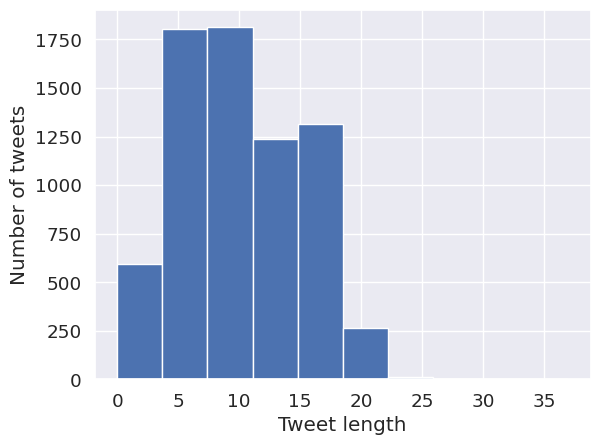

In [37]:
plt.hist(X_train['length'])
plt.xlabel('Tweet length')
plt.ylabel('Number of tweets')
plt.show()

In [38]:
import collections

collections.Counter(X_train.query("length < 4")['length'].values)

Counter({3: 317, 2: 203, 1: 68, 0: 7})

In [41]:
import pandas as pd

l_train = X_train.query("length < 4")[['tweet', 'Light Stemming', 'label']]
l_train['label'] = l_train['label'].map(label_to_class)

In [89]:
classes

['none', 'anger', 'joy', 'sadness', 'love', 'sympathy', 'surprise', 'fear']

In [42]:
l_train

,tweet,Light Stemming,label
17,: altoaimi مشكوره ام عبدالله,مشكوره ام عبدالله,joy
75,!!! هو الهزار ممنوع ايه الاسلوب دا,الهزار ممنوع الاسلوب,surprise
78,و انت بخييييييييييييييييير يا كبير,بخير كبير,joy
81,wahba ايوه بقي يا سلام علي الكلام,ايوه سلام الكلام,joy
87,الله ينصرهم,الله ينصر,sympathy
...,...,...,...
6971,خلاص انسي يا صاحبي,خلاص انسي صاحبي,sadness
6984,: الشوق احتياج وانا احتاجك ....,الشوق احتياج احتاجك,love
7026,انا كنت نعمه وانتي مفهمتيش,نعمه وانتي مفهمتيش,sadness
7033,ممكن خايفه من العين 🤔,ممكن خايفه الع,fear


###Incorrect Labels

In [50]:
l_train.iloc[62]

tweet             يا بنت دين الاوليمبياد
Light Stemming       بنت دين الاوليمبياد
label                               none
Name: 694, dtype: object

You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


predicted label: none


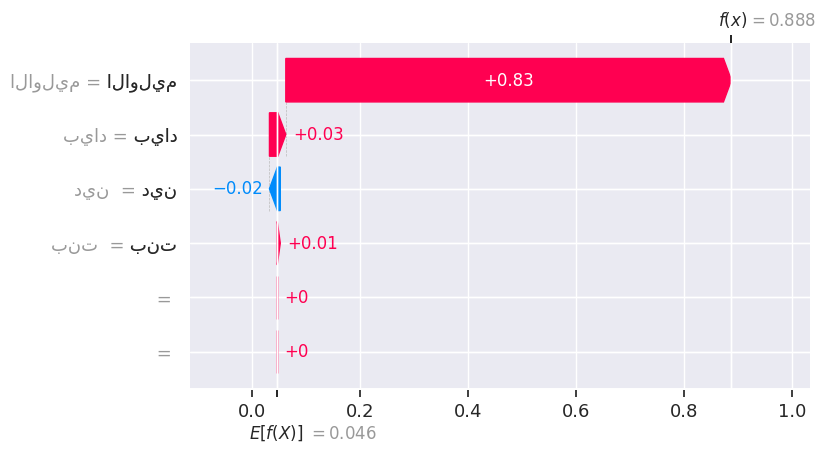

In [74]:
index = 62
print(f"predicted label: {classes[np.argmax(predict_proba(l_train[index:index+1]['Light Stemming']))]}")
sv = shap_explainer(l_train[index:index+1]['Light Stemming'])
show = sv[0, :, 0] # explain none
waterfall(show)

In [52]:
l_train.iloc[15+476]

tweet             ME  A مرحبا
Light Stemming          مرحبا
label                     joy
Name: 5816, dtype: object

predicted label: joy


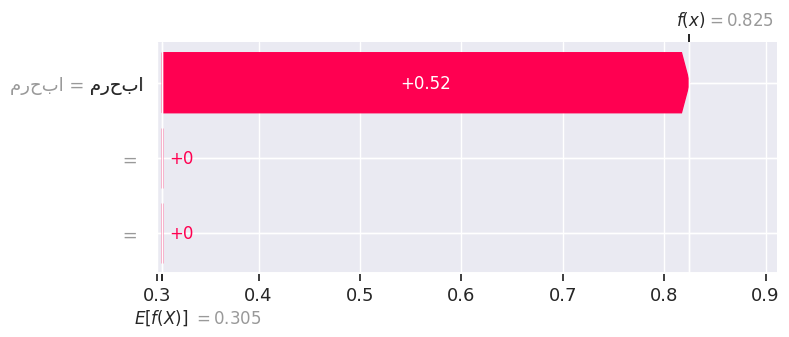

In [77]:
index = 15+476
print(f"predicted label: {classes[np.argmax(predict_proba(l_train[index:index+1]['Light Stemming']))]}")
sv = shap_explainer(l_train[index:index+1]['Light Stemming'])
show = sv[0, :, 2] # explain joy
waterfall(show)

In [56]:
l_train.iloc[526+6]

tweet             دلق القهوه خييييير
Light Stemming        دلق القهوه خير
label                            joy
Name: 6248, dtype: object

predicted label: joy


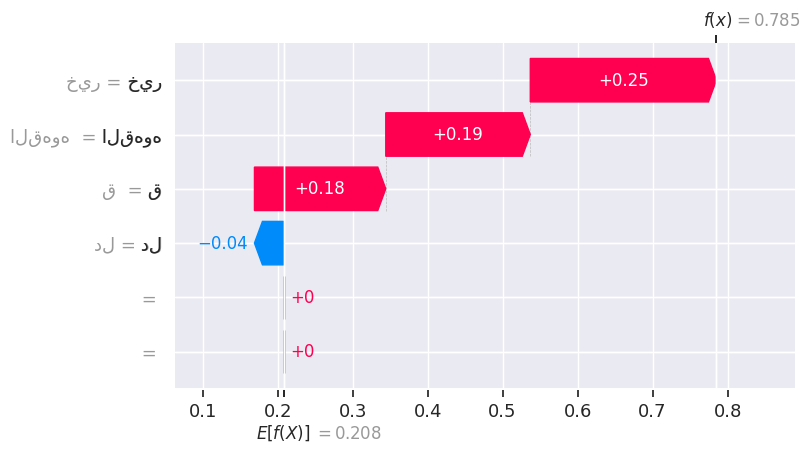

In [78]:
index = 526+6
print(f"predicted label: {classes[np.argmax(predict_proba(l_train[index:index+1]['Light Stemming']))]}")
sv = shap_explainer(l_train[index:index+1]['Light Stemming'])
show = sv[0, :, 2] # explain joy
waterfall(show)

In [59]:
l_train.iloc[574]

tweet             ربنا معااكو ومعانا 🙏
Light Stemming         ربنا معاكو ومعا
label                             fear
Name: 6736, dtype: object

predicted label: sympathy


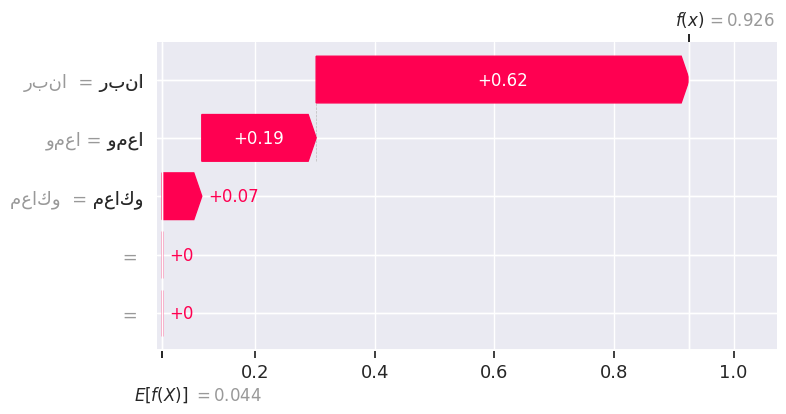

In [81]:
index = 574
print(f"predicted label: {classes[np.argmax(predict_proba(l_train[index:index+1]['Light Stemming']))]}")
sv = shap_explainer(l_train[index:index+1]['Light Stemming'])
show = sv[0, :, 5] # explain sympathy
waterfall(show)

###Mixed Feelings

In [61]:
l_train.iloc[21]

tweet             IHFC20 ذا اللي خايفه منه💔
Light Stemming                    خايفه حزن
label                                  fear
Name: 284, dtype: object

predicted label: fear


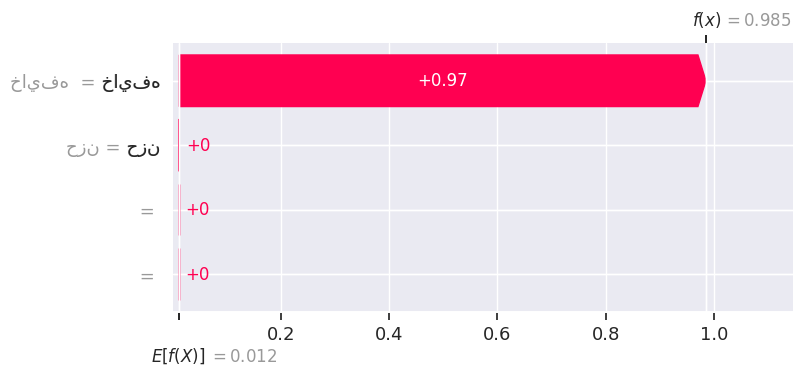

In [83]:
index = 21
print(f"predicted label: {classes[np.argmax(predict_proba(l_train[index:index+1]['Light Stemming']))]}")
sv = shap_explainer(l_train[index:index+1]['Light Stemming'])
show = sv[0, :, 7] # explain fear
waterfall(show)

In [85]:
l_train.iloc[48]

tweet               خايف 😂
Light Stemming    خايف فرح
label                 fear
Name: 557, dtype: object

You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


predicted label: fear


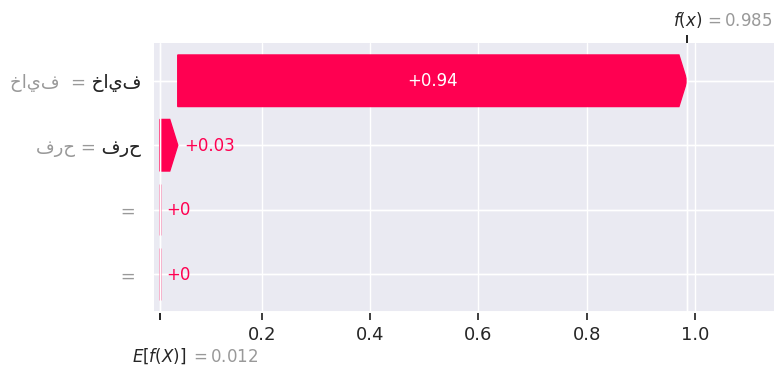

In [86]:
index = 48
print(f"predicted label: {classes[np.argmax(predict_proba(l_train[index:index+1]['Light Stemming']))]}")
sv = shap_explainer(l_train[index:index+1]['Light Stemming'])
show = sv[0, :, 7] # explain fear
waterfall(show)

In [87]:
l_train.iloc[89]

tweet             لانو حرام اللي بصير معكم
Light Stemming              لانو حرام بصير
label                             sympathy
Name: 1002, dtype: object

You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


predicted label: sadness


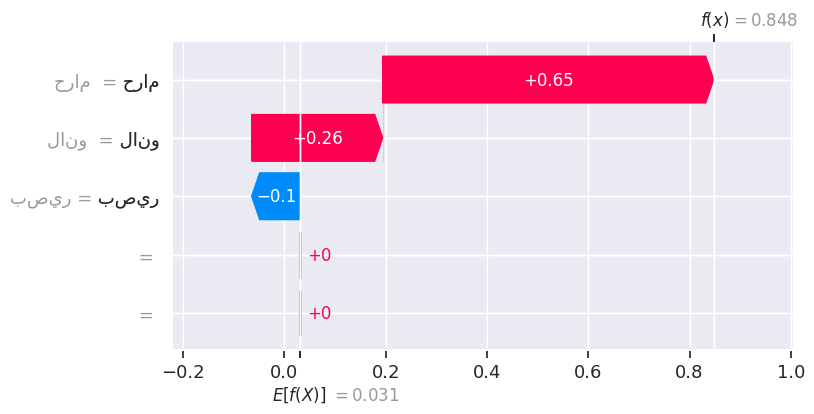

In [90]:
index = 89
print(f"predicted label: {classes[np.argmax(predict_proba(l_train[index:index+1]['Light Stemming']))]}")
sv = shap_explainer(l_train[index:index+1]['Light Stemming'])
show = sv[0, :, 3] # explain sadness
waterfall(show)

###Context Misunderstanding

In [130]:
import pandas as pd

ll_train = X_train.query("length == 10")[['tweet', 'Light Stemming', 'label']]
ll_train['label'] = ll_train['label'].map(label_to_class)

In [131]:
ll_train

,tweet,Light Stemming,label
3,الصراحه احساس مخزي ونحن نكتفي بالتمثيل المشرف ...,الصراحه احساس مخزي نكتفي بالتمثيل المشرف الاول...,sadness
23,الذي يؤمن بتساوي القدرات البدنيه بين الرجل وال...,يؤمن بتساوي القدر البدنيه الرجل والمراه يتابع ...,none
26,مايكل فيليبس هيلعب اخر ماتش ليه في الاوليمبياد...,مايكل فيليبس هيلعب ماتش ليه الاوليمبياد كمان ش...,none
35,هتلر كان بيتفرج عليه و اتجنن من انجازه و كان ح...,هتلر بيتفرج اتجنن انجازه حديث الاوليمبياد اتعم...,none
62,احا هو حسن شحاته مخدش علاء ميهوب للمنتخب ؟! ال...,احا حسن شحاته مخدش علاء ميهوب للمنتخب التهريج ...,surprise
...,...,...,...
6969,انا يمكن اهم حاجه استنتجتها من الاوليمبياد دي ...,يمكن اهم حاجه استنتجت الاوليمبياد انها المستحي...,none
6995,لاعبنا الجديد جونيور اجاي(نيجيريا)VS اليابان ا...,لاعب الجديد جونيور اجاينيجير الياب الماتش ابو ...,none
7004,هو ان تستغني بمن تُحب عن العالم اجمع .. الا تش...,تستغ تحب العالم اجمع تشعر برغبه شيء يكفيك وجود...,love
7005,يا جدعان الحفله بتاعه افتتاح الاوليمبياد بيحصل...,جدع الحفله بتاعه افتتاح الاوليمبياد بيحصل اعجا...,none


In [132]:
index = 23
print(ll_train.iloc[index]['tweet'])
print(ll_train.iloc[index]['Light Stemming'])
print(f"true label: {ll_train.iloc[index]['label']}")

لا عشان نادال خسر في نص نهائي الاوليمبياد ما تشغلش بالك 😂
لا عشان نادال خسر نص نهائي الاوليمبياد تشغلش بالك فرح
true label: none


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


predicted label: joy


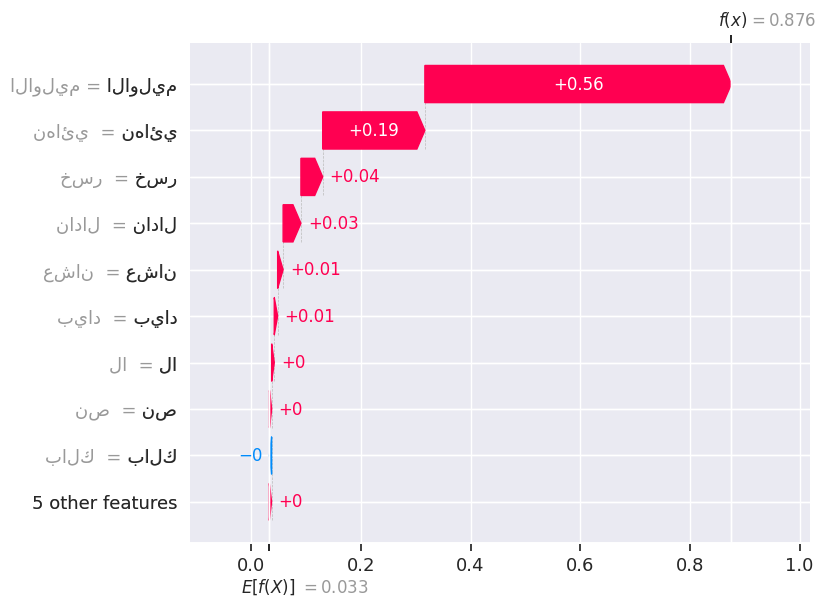

In [133]:
print(f"predicted label: {classes[np.argmax(predict_proba(l_train[index:index+1]['Light Stemming']))]}")
sv = shap_explainer(ll_train[index:index+1]['Light Stemming'])
show = sv[0, :, 0] # explain none
waterfall(show)

predicted label: joy


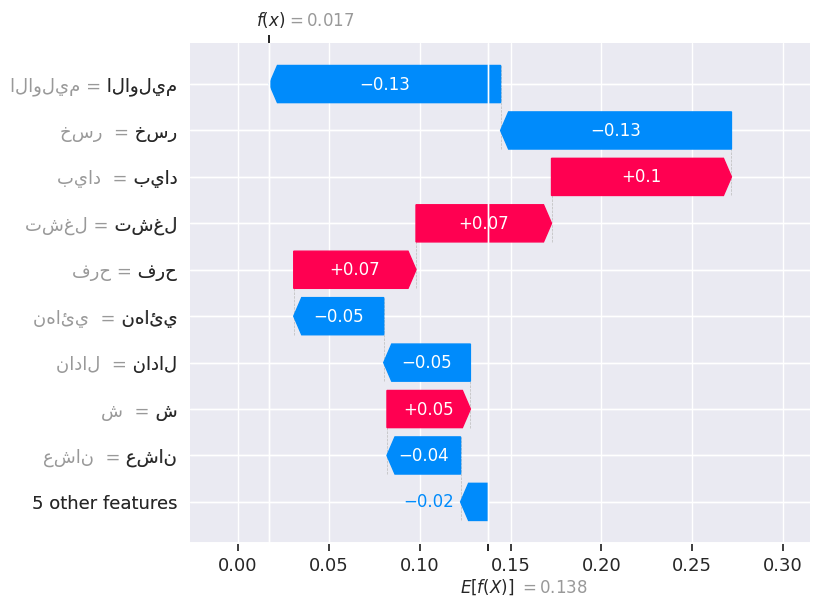

In [134]:
print(f"predicted label: {classes[np.argmax(predict_proba(l_train[index:index+1]['Light Stemming']))]}")
sv = shap_explainer(ll_train[index:index+1]['Light Stemming'])
show = sv[0, :, 2] # explain joy
waterfall(show)

In [135]:
index = 388
print(ll_train.iloc[index]['tweet'])
print(ll_train.iloc[index]['Light Stemming'])
print(f"true label: {ll_train.iloc[index]['label']}")

الاغنيه دي انا حبتها واول مره اسمعها كانت من يوسف  رنا سماحه مع عمرو الليثي
الاغنيه حبت واول مره اسمع يوسف رنا سماحه عمرو الليثي
true label: joy


predicted label: fear


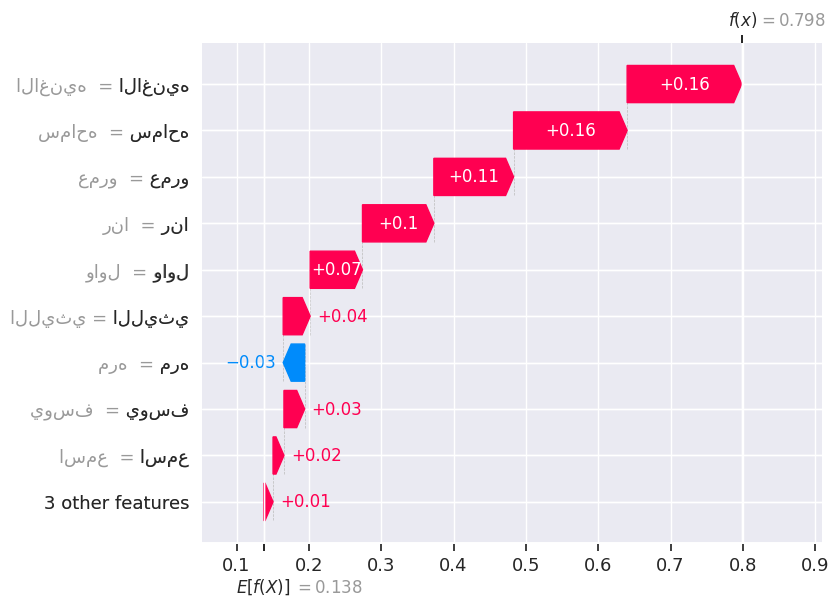

In [137]:
print(f"predicted label: {classes[np.argmax(predict_proba(l_train[index:index+1]['Light Stemming']))]}")
sv = shap_explainer(ll_train[index:index+1]['Light Stemming'])
show = sv[0, :, 2] # explain joy
waterfall(show)

predicted label: fear


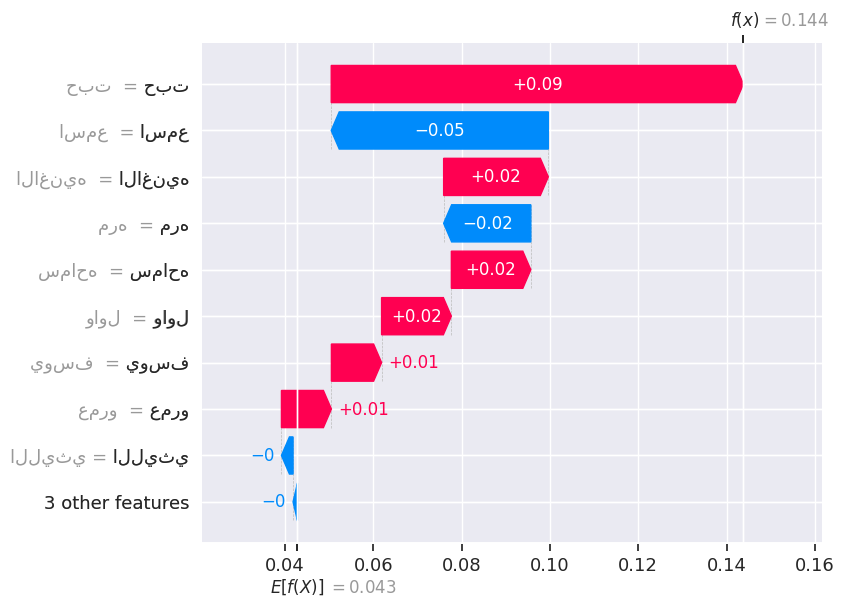

In [119]:
print(f"predicted label: {classes[np.argmax(predict_proba(l_train[index:index+1]['Light Stemming']))]}")
sv = shap_explainer(ll_train[index:index+1]['Light Stemming'])
show = sv[0, :, 4] # explain love
waterfall(show)

predicted label: fear


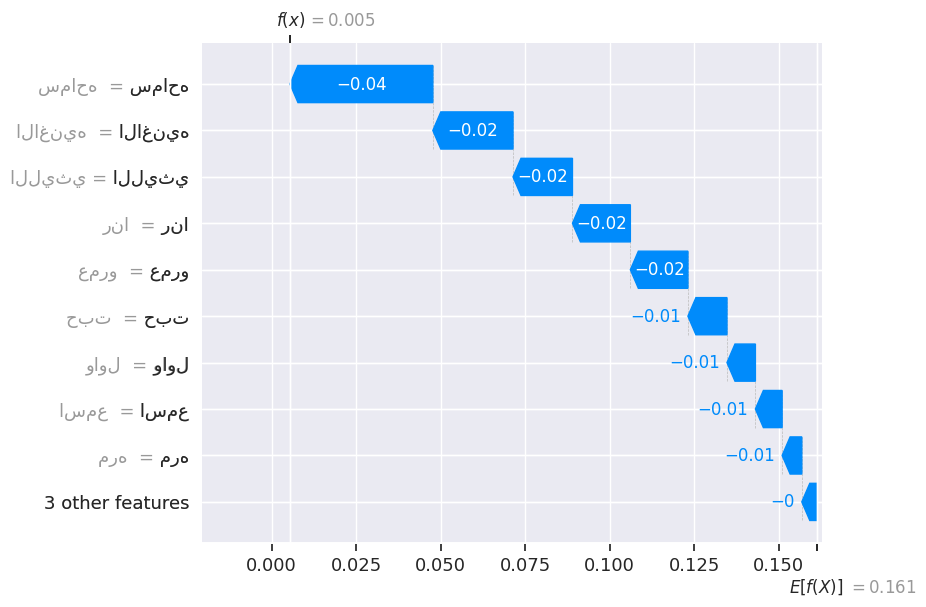

In [138]:
print(f"predicted label: {classes[np.argmax(predict_proba(l_train[index:index+1]['Light Stemming']))]}")
sv = shap_explainer(ll_train[index:index+1]['Light Stemming'])
show = sv[0, :, 7] # explain fear
waterfall(show)

###Short Statements

In [93]:
label_to_class

{0: 'none',
 1: 'anger',
 2: 'joy',
 3: 'sadness',
 4: 'love',
 5: 'sympathy',
 6: 'surprise',
 7: 'fear'}

In [96]:
class_to_label = {
    'none': 0,
    'anger': 1,
    'joy': 2,
    'sadness': 3,
    'love': 4,
    'sympathy': 5,
    'surprise': 6,
    'fear': 7
    }

In [ ]:
l_train = l_train.rename_axis('id')
l_train = l_train.reset_index(drop=True)
l_train = Dataset.from_pandas(l_train)

l_train = l_train.map(tokenize_function, batched=True, num_proc = 8)

In [98]:
from torch.utils.data import TensorDataset, DataLoader
from sklearn.metrics import classification_report

input_ids = [i['input_ids'] for i in l_train]
attention_masks = [i['attention_mask'] for i in l_train]

samples_inputs = torch.tensor(input_ids)
samples_masks = torch.tensor(attention_masks)
sample_data = TensorDataset(samples_inputs, samples_masks)

samples_dataloader = DataLoader(sample_data)

pred_labels = []

model.eval()
for input, masks in samples_dataloader:
    torch.cuda.empty_cache()

    input = input.to(device)
    masks = masks.to(device)

    output = model(input, attention_mask=masks)['logits']
    predictions = torch.argmax(output, dim=1)
    predictions = predictions.cpu().detach().numpy()

    pred_labels.extend(predictions)

true_labels = l_train.to_pandas()['label'].map(class_to_label).values.tolist()

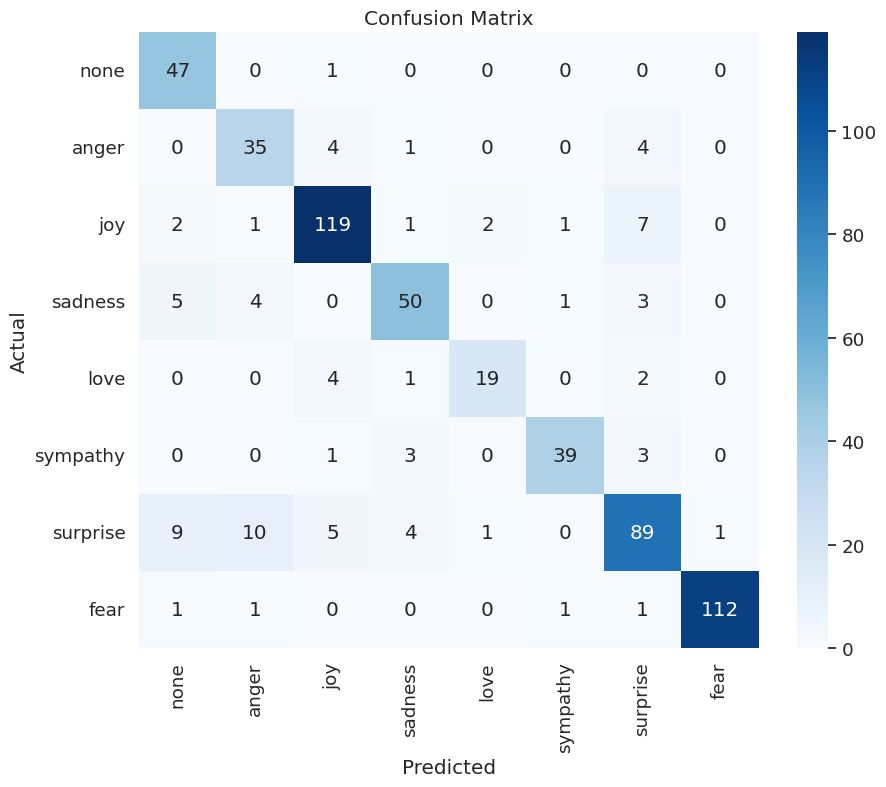

In [99]:
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

cm = confusion_matrix(true_labels, pred_labels)

plt.figure(figsize=(10, 8))
sns.set(font_scale=1.2)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=classes, yticklabels=classes)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()